<a href="https://colab.research.google.com/github/RifatRudro/Data-Science-Work/blob/main/MIS_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


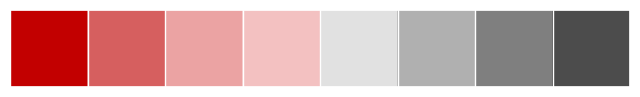

In [160]:
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')
import os
import re
import time
import nltk
import torch
import timeit
import string
import random
import zipfile
import datetime
import textwrap
import torchtext
import numpy as np
import pandas as pd
import seaborn as sns
from PIL import Image
from tqdm import tqdm
import tensorflow as tf
import matplotlib as mpl
import scipy.stats as st
import missingno as msno
from tqdm.auto import tqdm
from rich.text import Text
import plotly.express as px
from tensorflow import keras
from bs4 import BeautifulSoup
from string import punctuation
from collections import Counter
import matplotlib.pyplot as plt
from rich.console import Console
from sklearn.utils import shuffle
from nltk.corpus import stopwords
import nltk
#from transformers import pipeline # Commenting out this line since it is causing the error and doesn't seem to be used.
import matplotlib.ticker as ticker
import tensorflow_datasets as tfds
from keras.models import Sequential
from torchtext import data, datasets
from keras.layers import Dense, Dropout
from IPython.display import display, HTML
from ydata_profiling import ProfileReport
from wordcloud import WordCloud, STOPWORDS
from matplotlib.ticker import NullFormatter
from matplotlib.ticker import FuncFormatter
from IPython.display import HTML, display, Markdown
from tensorflow.keras import regularizers
from tensorflow.keras.utils import plot_model
from tensorflow.keras.models import load_model
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from torch.utils.data import TensorDataset, DataLoader, RandomSampler, SequentialSampler, TensorDataset
from tensorflow.keras.layers import Embedding, SpatialDropout1D, Bidirectional, LSTM, Dense, Dropout
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import ToktokTokenizer
from nltk.stem.porter import PorterStemmer
from nltk.tokenize.toktok import ToktokTokenizer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import CountVectorizer,TfidfTransformer
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
from transformers import DistilBertForSequenceClassification, AdamW, DistilBertTokenizer, BertTokenizer, BertForSequenceClassification, AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
nltk.download('stopwords')
sns.set(color_codes = True)
sns.set_palette(palette = 'RdGy', n_colors = 8)
colors = ["#C20000", "#D65F5F", "#EBA3A3", "#F3C1C1", "#E1E1E1", "#B0B0B0", "#7F7F7F", "#4C4C4C"]
sns.palplot(sns.color_palette(colors))
sns.set(style="whitegrid")

In [161]:
!pip install --upgrade gspread google-auth


In [162]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [163]:
import gspread
from google.colab import auth
from google.auth import default


In [164]:
data = pd.read_csv('/content/product_info.csv')

In [165]:
df = pd.DataFrame(data)
df

,product_id,product_name,brand_id,brand_name,loves_count,rating,reviews,size,variation_type,variation_value,...,online_only,out_of_stock,sephora_exclusive,highlights,primary_category,secondary_category,tertiary_category,child_count,child_max_price,child_min_price
0,P473671,Fragrance Discovery Set,6342,19-69,6320,3.6364,11.0,NaN,NaN,NaN,...,1,0,0,"['Unisex/ Genderless Scent', 'Warm &Spicy Scen...",Fragrance,Value & Gift Sets,Perfume Gift Sets,0,NaN,NaN
1,P473668,La Habana Eau de Parfum,6342,19-69,3827,4.1538,13.0,3.4 oz/ 100 mL,Size + Concentration + Formulation,3.4 oz/ 100 mL,...,1,0,0,"['Unisex/ Genderless Scent', 'Layerable Scent'...",Fragrance,Women,Perfume,2,85.0,30.0
2,P473662,Rainbow Bar Eau de Parfum,6342,19-69,3253,4.2500,16.0,3.4 oz/ 100 mL,Size + Concentration + Formulation,3.4 oz/ 100 mL,...,1,0,0,"['Unisex/ Genderless Scent', 'Layerable Scent'...",Fragrance,Women,Perfume,2,75.0,30.0
3,P473660,Kasbah Eau de Parfum,6342,19-69,3018,4.4762,21.0,3.4 oz/ 100 mL,Size + Concentration + Formulation,3.4 oz/ 100 mL,...,1,0,0,"['Unisex/ Genderless Scent', 'Layerable Scent'...",Fragrance,Women,Perfume,2,75.0,30.0
4,P473658,Purple Haze Eau de Parfum,6342,19-69,2691,3.2308,13.0,3.4 oz/ 100 mL,Size + Concentration + Formulation,3.4 oz/ 100 mL,...,1,0,0,"['Unisex/ Genderless Scent', 'Layerable Scent'...",Fragrance,Women,Perfume,2,75.0,30.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8489,P467659,Couture Clutch Eyeshadow Palette,1070,Yves Saint Laurent,2790,4.4286,7.0,NaN,NaN,NaN,...,0,0,0,NaN,Makeup,Eye,Eye Palettes,0,NaN,NaN
8490,P500874,L'Homme Eau de Parfum,1070,Yves Saint Laurent,2319,4.6367,556.0,2 oz / 60 mL,Size + Concentration + Formulation,2 oz / 60 mL eau de parfum spray,...,0,0,0,"['Layerable Scent', 'Woody & Earthy Scent']",Fragrance,Men,Cologne,1,129.0,129.0
8491,P504428,Mon Paris Eau de Parfum Gift Set,1070,Yves Saint Laurent,1475,5.0000,2.0,NaN,NaN,NaN,...,1,1,0,NaN,Fragrance,Value & Gift Sets,Perfume Gift Sets,0,NaN,NaN
8492,P504448,Y Eau de Parfum Gift Set,1070,Yves Saint Laurent,840,NaN,NaN,NaN,NaN,NaN,...,1,0,0,NaN,Fragrance,Value & Gift Sets,Cologne Gift Sets,0,NaN,NaN


In [166]:
# separating the skincare-related data from other categories such as makeup to ensure precise analysis and insights
string_to_check =['Remover' , 'remover' , 'Cleanser' , 'cleanser' , 'Make up cleanser' , 'bb cream' , 'bbcream' , 'BB' , 'Mask' , 'Masks' , 'mask' , 'Lip balm' , 'lip balm' , 'balm' , 'Gel' , 'gel' , 'make up remover' , 'Make up remover' ,'Hairdresser', 'Curl','Repair','Thickening',"Hairdresser",'Heat' ,'shampoo','Shampoo','hair','haircare','Haircare','Style','Styler','style','scalp','Scalp','Conditioner','conditioner','Frizz']
df = df[df['product_name'].str.contains('|'.join(string_to_check))]
df.reset_index()

,index,product_id,product_name,brand_id,brand_name,loves_count,rating,reviews,size,variation_type,...,online_only,out_of_stock,sephora_exclusive,highlights,primary_category,secondary_category,tertiary_category,child_count,child_max_price,child_min_price
0,18,P483068,ABBOTT Sampler Set,6485,ABBOTT,4493,4.8163,49.0,NaN,NaN,...,0,1,0,"['Vegan', 'Woody & Earthy Scent', 'Clean + Pla...",Fragrance,Value & Gift Sets,Perfume Gift Sets,0,NaN,NaN
1,47,P474806,Blue Tansy Reparative Mask,6321,adwoa beauty,14660,4.7581,492.0,16 oz/ 453 mg,Size,...,0,0,1,"['Good for: Damage', 'Good for: Color Care', '...",Hair,Hair Styling & Treatments,Hair Masks,0,NaN,NaN
2,48,P457233,Baomint Leave In Conditioning Styler,6321,adwoa beauty,13333,4.3472,144.0,14 oz/ 414 mL,Size,...,0,0,1,"['Clean at Sephora', 'All Hair Types', 'Curl-E...",Hair,Hair Styling & Treatments,Leave-In Conditioner,1,13.0,13.0
3,49,P474808,Blue Tansy Leave in Conditioning Styler,6321,adwoa beauty,11674,4.5762,210.0,14 oz/ 414 mL,Size,...,0,0,0,"['Good for: Damage', 'Vegan', 'Clean at Sephor...",Hair,Hair Styling & Treatments,Leave-In Conditioner,0,NaN,NaN
4,50,P457234,Baomint Moisturizing Shampoo,6321,adwoa beauty,11122,4.1324,136.0,14 oz/ 414 mL,Size,...,0,0,1,"['Unisex/ Genderless Scent', 'Clean at Sephora...",Hair,Shampoo & Conditioner,Shampoo,1,12.0,12.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1808,8404,P440307,Superberry Hydrate + Glow Dream Night Mask wit...,6169,Youth To The People,248887,4.3237,2354.0,2 oz/ 59 mL,Size,...,0,0,0,"['Vegan', 'Good for: Dullness/Uneven Texture',...",Skincare,Masks,Face Masks,1,18.0,18.0
1809,8405,P461555,Mini Superberry Hydrate + Glow Dream Mask,6169,Youth To The People,79524,4.3237,2354.0,0.5 oz/ 15 mL,Size,...,0,0,0,"['Good for: Dullness/Uneven Texture', 'allure ...",Skincare,Mini Size,NaN,0,NaN,NaN
1810,8418,P470065,Superclay Purify + Clear Power Mask with Niaci...,6169,Youth To The People,62672,4.4595,346.0,2.0 oz/ 60 mL,Size,...,0,0,0,"['Vegan', 'Best for Oily Skin', 'Good for: Por...",Skincare,Masks,Face Masks,0,NaN,NaN
1811,8460,P502049,Libre Eau de Parfum Lifestyle Gift Set,1070,Yves Saint Laurent,16392,4.0000,4.0,NaN,NaN,...,0,1,0,NaN,Fragrance,Value & Gift Sets,Perfume Gift Sets,0,NaN,NaN


In [167]:
df.columns

Index(['product_id', 'product_name', 'brand_id', 'brand_name', 'loves_count',
       'rating', 'reviews', 'size', 'variation_type', 'variation_value',
       'variation_desc', 'ingredients', 'price_usd', 'value_price_usd',
       'sale_price_usd', 'limited_edition', 'new', 'online_only',
       'out_of_stock', 'sephora_exclusive', 'highlights', 'primary_category',
       'secondary_category', 'tertiary_category', 'child_count',
       'child_max_price', 'child_min_price'],
      dtype='object')

In [168]:
df.shape

(1813, 27)

In [169]:
def check_df(df: object, head: object = 5) -> object:
    print("\nShape")
    print(df.shape)
    print("\nTypes")
    print(df.dtypes)
    print("\nNANs")
    print(df.isnull().sum())
    print("\nInfo")
    print(df.info())
check_df(df)


Shape
(1813, 27)

Types
product_id             object
product_name           object
brand_id                int64
brand_name             object
loves_count             int64
rating                float64
reviews               float64
size                   object
variation_type         object
variation_value        object
variation_desc         object
ingredients            object
price_usd             float64
value_price_usd       float64
sale_price_usd        float64
limited_edition         int64
new                     int64
online_only             int64
out_of_stock            int64
sephora_exclusive       int64
highlights             object
primary_category       object
secondary_category     object
tertiary_category      object
child_count             int64
child_max_price       float64
child_min_price       float64
dtype: object

NANs
product_id               0
product_name             0
brand_id                 0
brand_name               0
loves_count              0
rating    

In [170]:
print('Number of duplicated rows: ' , len(df[df.duplicated()]))

Number of duplicated rows:  0


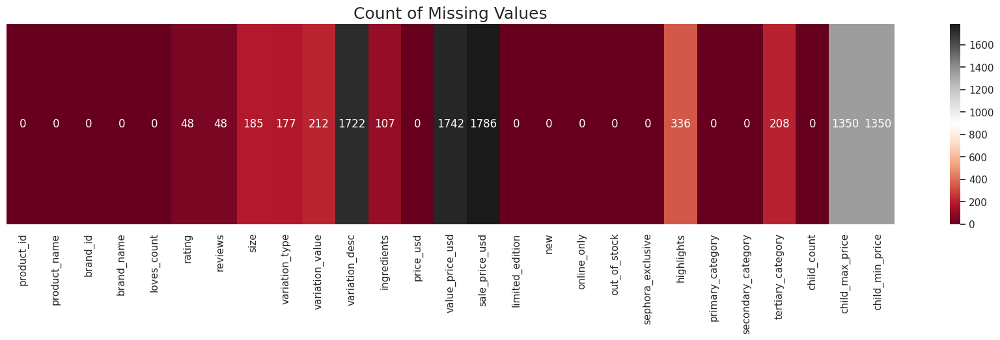

In [171]:
plt.figure(figsize=(22,4))
sns.heatmap((df.isna().sum()).to_frame(name='').T,cmap='RdGy', annot=True,
             fmt='0.0f').set_title('Count of Missing Values', fontsize=18)
plt.show()

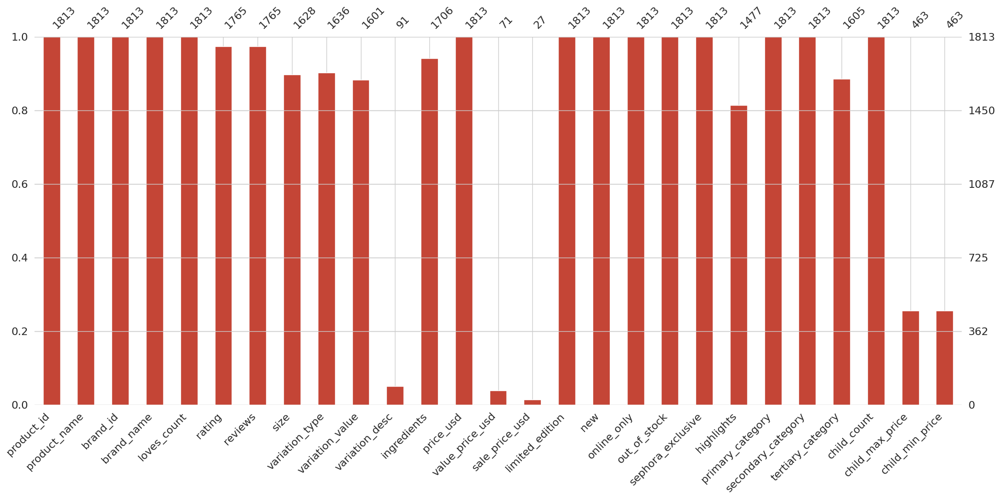

In [172]:
msno.bar(df, color='#C44536')
plt.show()

In [173]:
df.describe().T.style.background_gradient(cmap='RdGy', axis=1)

,count,mean,std,min,25%,50%,75%,max
brand_id,1813.000000,5840.567568,1239.040577,1065.000000,5972.000000,6201.000000,6346.000000,8020.000000
loves_count,1813.000000,20632.468836,45781.130164,0.000000,2966.000000,7877.000000,19870.000000,1081315.000000
rating,1765.000000,4.210648,0.502511,1.000000,4.000000,4.300000,4.546100,5.000000
reviews,1765.000000,387.971105,816.226752,1.000000,35.000000,138.000000,386.000000,16118.000000
price_usd,1813.000000,39.982791,55.011441,3.500000,22.000000,31.000000,44.000000,1900.000000
value_price_usd,71.000000,80.098592,54.563961,20.000000,46.000000,62.000000,90.500000,290.000000
sale_price_usd,27.000000,12.944074,8.219116,3.000000,7.000000,10.500000,18.995000,32.250000
limited_edition,1813.000000,0.028130,0.165390,0.000000,0.000000,0.000000,0.000000,1.000000
new,1813.000000,0.069498,0.254369,0.000000,0.000000,0.000000,0.000000,1.000000
online_only,1813.000000,0.258687,0.438034,0.000000,0.000000,0.000000,1.000000,1.000000


In [174]:
# finding unique data
df.apply(lambda x: len(x.unique()))

,0
product_id,1813
product_name,1796
brand_id,196
brand_name,196
loves_count,1735
rating,1289
reviews,662
size,537
variation_type,7
variation_value,551


In [175]:
# Converting int DataYypes to boolean
df['limited_edition'] = df['limited_edition'].astype(bool)
df['new']= df['new'].astype(bool)
df['online_only']= df['online_only'].astype(bool)
df['out_of_stock'] = df['out_of_stock'].astype(bool)
df['sephora_exclusive'] = df['sephora_exclusive'].astype(bool)
df[['limited_edition', 'new', 'online_only', 'out_of_stock', 'sephora_exclusive']]

,limited_edition,new,online_only,out_of_stock,sephora_exclusive
18,False,False,False,True,False
47,False,False,False,False,True
48,False,False,False,False,True
49,False,False,False,False,False
50,False,False,False,False,True
...,...,...,...,...,...
8404,False,False,False,False,False
8405,False,False,False,False,False
8418,False,False,False,False,False
8460,True,False,False,True,False


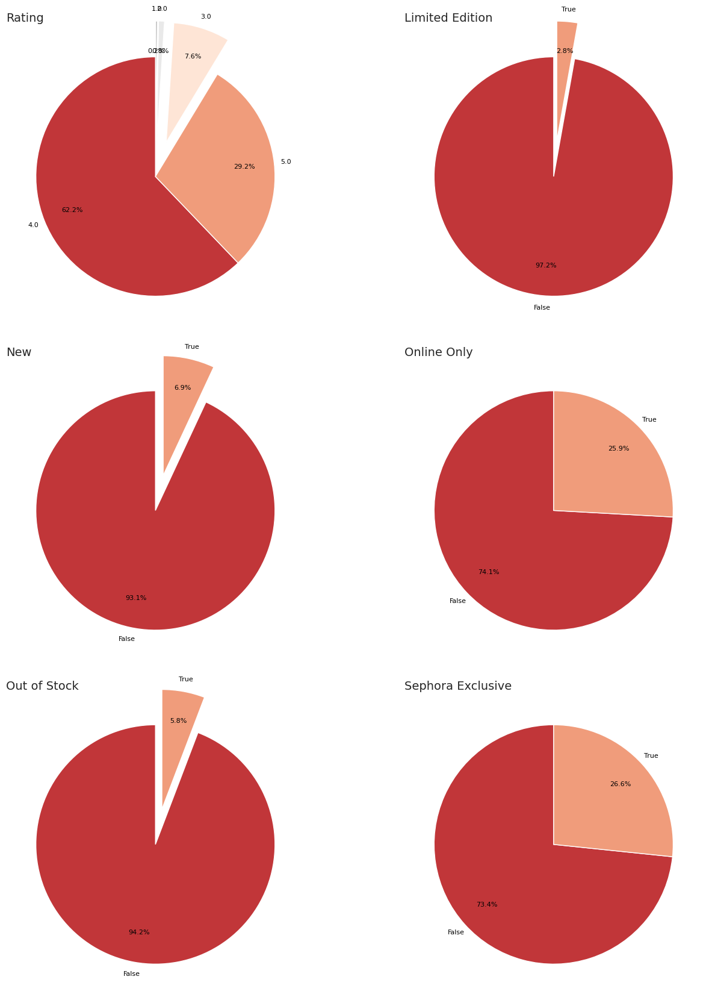

In [176]:
# Make a copy of the DataFrame
df5 = df.copy()

# Convert the 'rating' column to numeric (forcing errors to NaN)
df5['rating'] = pd.to_numeric(df5['rating'], errors='coerce')

# Now round the 'rating' column
df5['rounded_rating'] = df5['rating'].round()

# Plotting the pie charts
fig, ax = plt.subplots(figsize=(15, 17), nrows=3, ncols=2)
sns.set_palette("RdGy")

# Define the columns and titles
columns = ['rounded_rating', 'limited_edition', 'new', 'online_only', 'out_of_stock', 'sephora_exclusive']
titles = ['Rating', 'Limited Edition', 'New', 'Online Only', 'Out of Stock', 'Sephora Exclusive']

# Helper function to explode small values in the pie chart
def get_explode(values, threshold=10):
    total = sum(values)
    return [0.3 if (v / total) * 100 < threshold else 0 for v in values]

# Create the pie charts
for i, column in enumerate(columns):
    row = i // 2
    col = i % 2
    values = df5[column].value_counts()
    explode = get_explode(values)
    values.plot.pie(
        autopct='%1.1f%%', ax=ax[row, col], startangle=90,
        textprops={'color': 'black', 'fontsize': 8, 'ha': 'center', 'va': 'center'},
        pctdistance=0.75,
        explode=explode
    )
    ax[row, col].set_title(titles[i], fontsize=14, loc='left')
    ax[row, col].set_ylabel('')

# Adjust layout and display the plot
plt.tight_layout(pad=2.0)
plt.show()


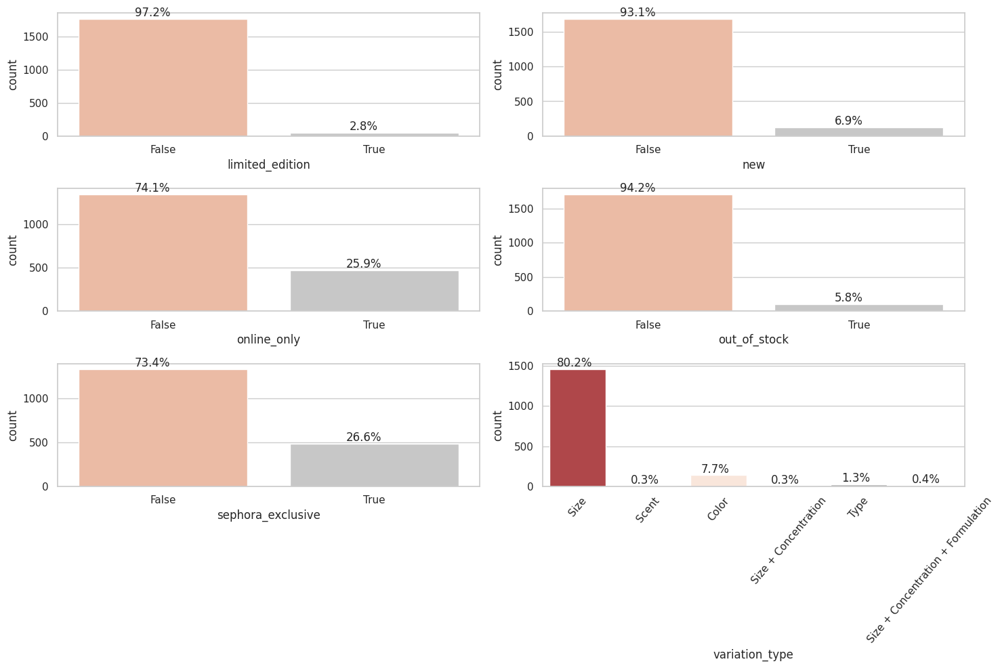

In [177]:
figure, axes = plt.subplots(3, 2, figsize=(15, 10))
dfff = ['limited_edition', 'new', 'online_only', 'out_of_stock', 'sephora_exclusive','variation_type']
palette = 'RdGy'
for i, genre in enumerate(dfff):
    row = i // 2
    col = i % 2
    ax = sns.countplot(ax=axes[row, col], x=df[genre], palette=palette)
    total = len(df[genre])
    for p in ax.patches:
        percentage = '{:.1f}%'.format(100 * p.get_height() / total)
        x = p.get_x() + p.get_width() / 2 - 0.05
        y = p.get_height()
        ax.annotate(percentage, (x, y), ha='center', va='bottom')
plt.xticks(rotation=50)
plt.tight_layout()
plt.show()

In [178]:
unique = df.nunique().sort_values()
unique_values = df.apply(lambda x: x.unique())
pd.DataFrame({'Number of Unique Values': unique, 'Unique Values': unique_values})

,Number of Unique Values,Unique Values
brand_id,196,"[6485, 6321, 7054, 6018, 6283, 6312, 5998, 710..."
brand_name,196,"[ABBOTT, adwoa beauty, AERIN, Algenist, Alpha-..."
child_count,18,"[0, 1, 2, 6, 15, 4, 25, 9, 5, 3, 10, 7, 13, 17..."
child_max_price,98,"[nan, 13.0, 12.0, 14.0, 23.0, 54.0, 36.0, 55.0..."
child_min_price,78,"[nan, 13.0, 12.0, 14.0, 23.0, 54.0, 36.0, 55.0..."
highlights,1106,"[['Vegan', 'Woody & Earthy Scent', 'Clean + Pl..."
ingredients,1489,"[['Big Sky:', 'Water, Denatured Ethyl Alcohol,..."
limited_edition,2,"[False, True]"
loves_count,1735,"[4493, 14660, 13333, 11674, 11122, 10753, 9921..."
new,2,"[False, True]"


In [179]:
ProfileReport(df, title='Products Dataset Report', minimal=True, progress_bar=False, samples=None, correlations=None, interactions=None, explorative=True, dark_mode=True, notebook={'iframe':{'height': '600px'}}, html={'style':{'primary_color': '#C44536'}}, missing_diagrams={'heatmap': False, 'dendrogram': False}).to_notebook_iframe()

In [180]:
# Dropping non-numerical data
hm = df.drop(columns=['limited_edition', 'new', 'online_only',
       'out_of_stock', 'sephora_exclusive', 'highlights', 'primary_category',
       'secondary_category', 'tertiary_category', 'child_count',
       'child_max_price', 'child_min_price', 'product_name', 'brand_name', 'ingredients', 'variation_type', 'variation_value', 'variation_desc'])

In [181]:
# Dropping non-numerical columns
hm = df.drop(columns=['limited_edition', 'new', 'online_only',
       'out_of_stock', 'sephora_exclusive', 'highlights', 'primary_category',
       'secondary_category', 'tertiary_category', 'child_count',
       'child_max_price', 'child_min_price', 'product_name', 'brand_name', 'ingredients', 'variation_type', 'variation_value', 'variation_desc'])

# Generate the correlation matrix (numeric_only=True to ignore non-numeric data)
correlation_matrix = hm.corr(numeric_only=True)

# Check the correlation matrix
print(correlation_matrix)


                 brand_id  loves_count    rating   reviews  price_usd  \
brand_id         1.000000    -0.018246  0.014293 -0.086881  -0.018328   
loves_count     -0.018246     1.000000  0.034695  0.765419  -0.035963   
rating           0.014293     0.034695  1.000000  0.100490   0.018267   
reviews         -0.086881     0.765419  0.100490  1.000000  -0.034668   
price_usd       -0.018328    -0.035963  0.018267 -0.034668   1.000000   
value_price_usd -0.136205    -0.156915 -0.010512  0.173900   0.742785   
sale_price_usd   0.147111    -0.156811 -0.361697 -0.139509   0.943712   

                 value_price_usd  sale_price_usd  
brand_id               -0.136205        0.147111  
loves_count            -0.156915       -0.156811  
rating                 -0.010512       -0.361697  
reviews                 0.173900       -0.139509  
price_usd               0.742785        0.943712  
value_price_usd         1.000000        0.800261  
sale_price_usd          0.800261        1.000000  


brand_id             int64
loves_count          int64
rating             float64
reviews            float64
price_usd          float64
value_price_usd    float64
sale_price_usd     float64
child_count          int64
child_max_price    float64
child_min_price    float64
dtype: object


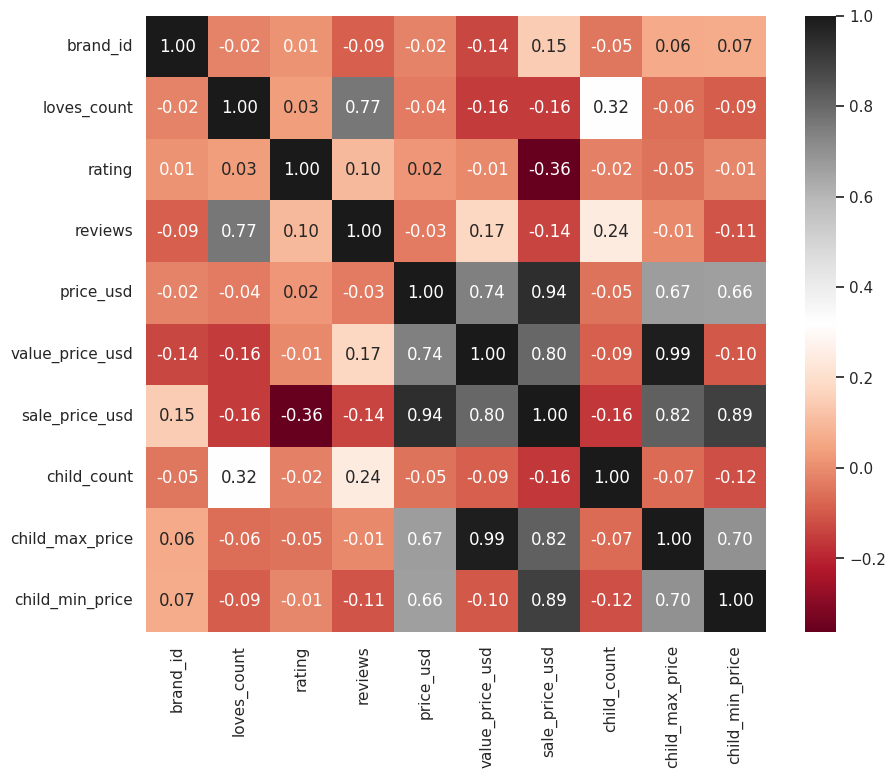

In [182]:
# Ensure only numeric columns are selected
hm = df.select_dtypes(include=[np.number])

# Check the remaining columns in the DataFrame
print(hm.dtypes)

# Generate the correlation matrix
correlation_matrix = hm.corr()

# Plot the heatmap using seaborn if the correlation matrix is valid
if not correlation_matrix.empty:
    plt.figure(figsize=(10, 8))
    sns.heatmap(correlation_matrix, annot=True, fmt='.2f', cmap='RdGy', cbar=True)
    plt.show()
else:
    print("No valid numeric data for correlation.")


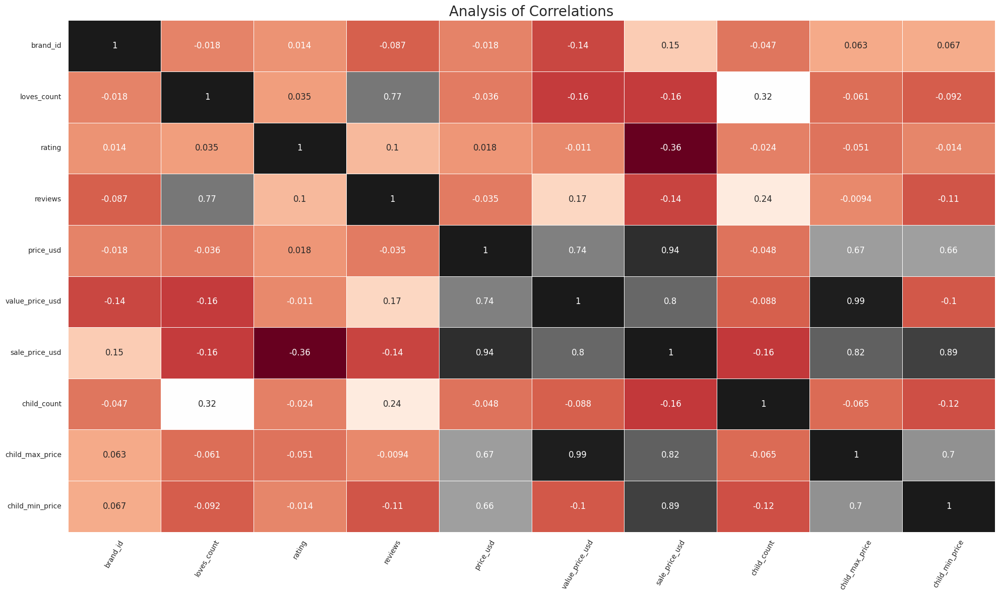

In [183]:
plt.figure(figsize=(20, 12))
sns.heatmap(hm.corr(numeric_only=True), cmap="RdGy", annot=True, linewidths=.6 , cbar = False)
plt.xticks(rotation=60, size=10)
plt.yticks(size=10)
plt.title('Analysis of Correlations', size=20)
plt.tight_layout()
plt.show()

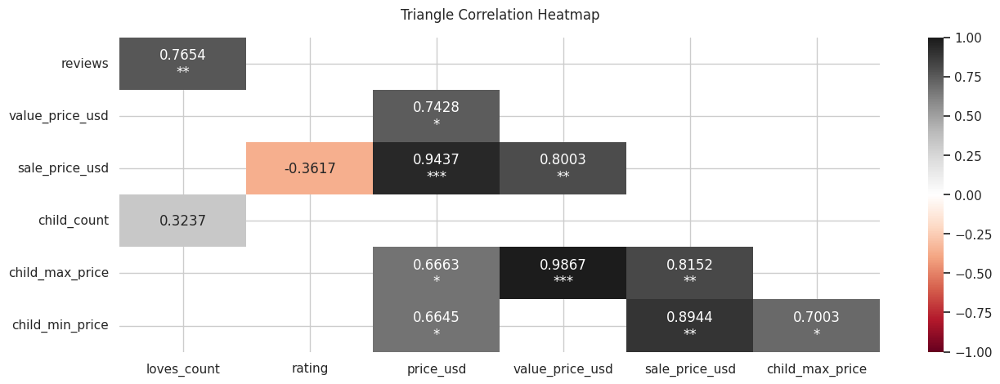

In [184]:
corr = hm.corr(numeric_only=True)
f, ax = plt.subplots(figsize=(15, 5))
mask = np.triu(np.ones_like(corr, dtype=bool))
cut_off = 0.25
extreme_1 = 0.5
extreme_2 = 0.75
extreme_3 = 0.9
mask |= np.abs(corr) < cut_off
corr = corr[~mask]
remove_empty_rows_and_cols = True
if remove_empty_rows_and_cols:
    wanted_cols = np.flatnonzero(np.count_nonzero(~mask, axis=1))
    wanted_rows = np.flatnonzero(np.count_nonzero(~mask, axis=0))
    corr = corr.iloc[wanted_cols, wanted_rows]

annot = [[f"{val:.4f}"
          + ('' if abs(val) < extreme_1 else '\n*')
          + ('' if abs(val) < extreme_2 else '*')
          + ('' if abs(val) < extreme_3 else '*')
          for val in row] for row in corr.to_numpy()]
heatmap = sns.heatmap(corr, vmin=-1, vmax=1, annot=annot, fmt='', cmap='RdGy')
heatmap.set_title('Triangle Correlation Heatmap', fontdict={'fontsize': 12}, pad=16)
plt.show()

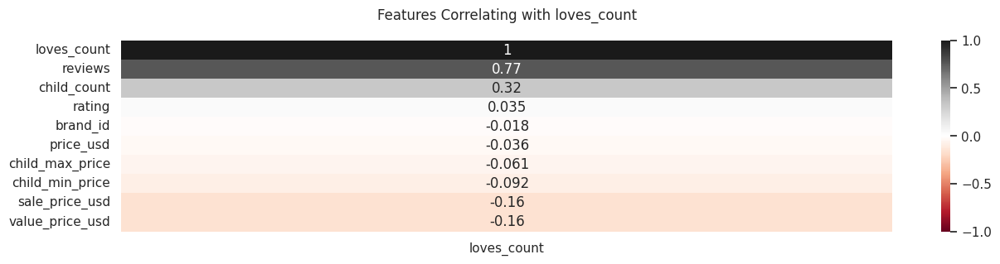

In [185]:
plt.figure (figsize = (15 , 3) , dpi = 100)
heatmap = sns.heatmap (hm.corr(numeric_only=True)[['loves_count']].sort_values (by = 'loves_count', ascending = False), vmin = -1, vmax = 1, annot = True, cmap = 'RdGy')
heatmap.set_title ('Features Correlating with loves_count', fontdict = {'fontsize':12} , pad = 18);

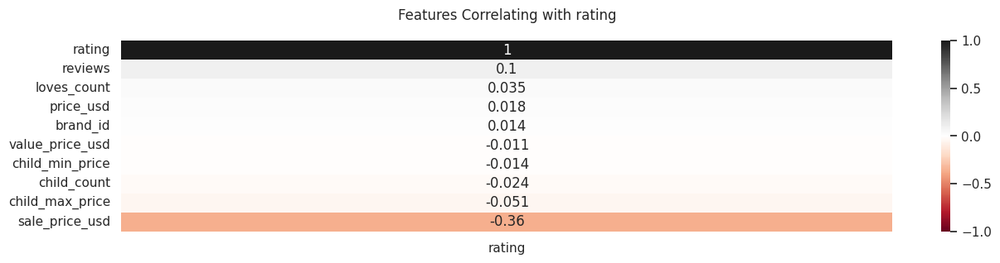

In [186]:
plt.figure (figsize = (15 , 3) , dpi = 100)
heatmap = sns.heatmap (hm.corr(numeric_only=True)[['rating']].sort_values (by = 'rating', ascending = False), vmin = -1, vmax = 1, annot = True, cmap = 'RdGy')
heatmap.set_title ('Features Correlating with rating', fontdict = {'fontsize':12} , pad = 18);

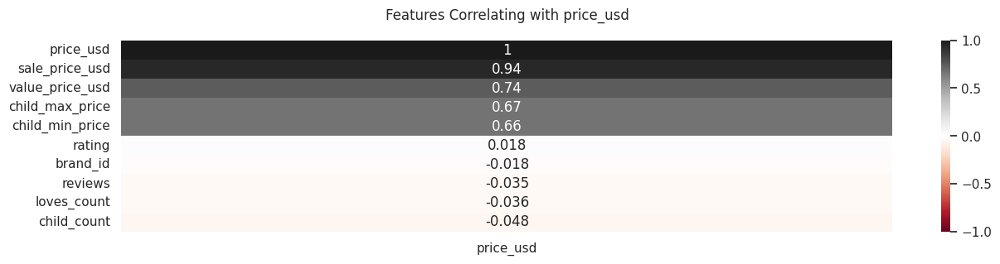

In [187]:
plt.figure (figsize = (15 , 3) , dpi = 100)
heatmap = sns.heatmap (hm.corr(numeric_only=True)[['price_usd']].sort_values (by = 'price_usd', ascending = False), vmin = -1, vmax = 1, annot = True, cmap = 'RdGy')
heatmap.set_title ('Features Correlating with price_usd', fontdict = {'fontsize':12} , pad = 18);

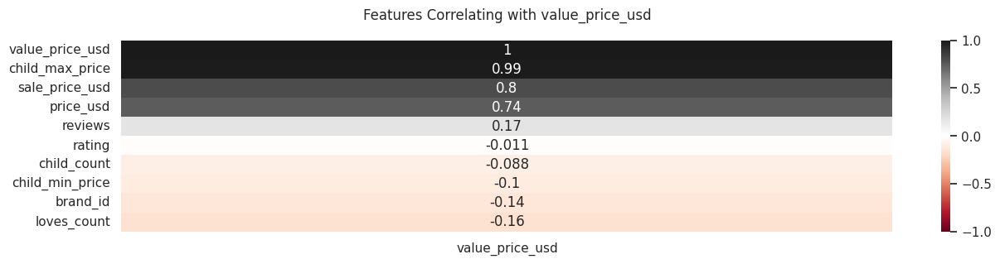

In [188]:
plt.figure (figsize = (15 , 3) , dpi = 100)
heatmap = sns.heatmap (hm.corr(numeric_only=True)[['value_price_usd']].sort_values (by = 'value_price_usd', ascending = False), vmin = -1, vmax = 1, annot = True, cmap = 'RdGy')
heatmap.set_title ('Features Correlating with value_price_usd', fontdict = {'fontsize':12} , pad = 18);

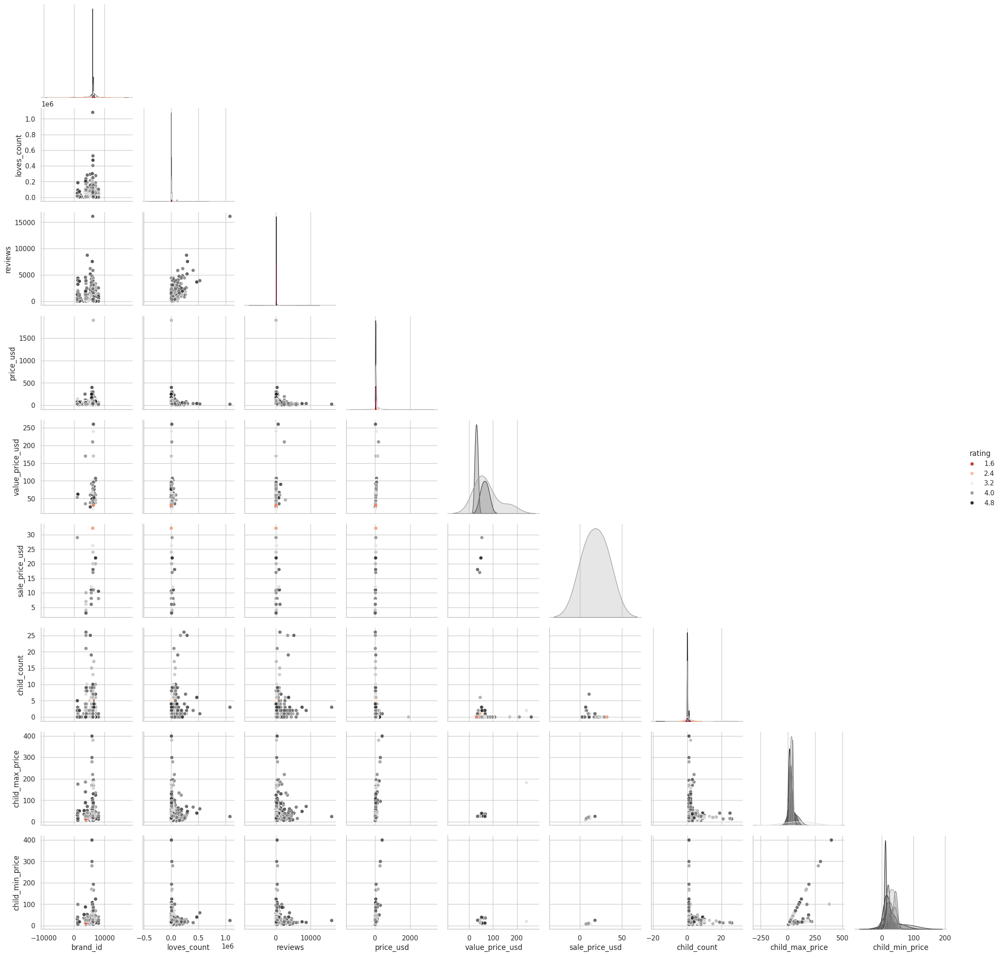

In [189]:
sns.pairplot(data=hm, diag_kind='kde', hue='rating', palette='RdGy',corner=True)
plt.show()

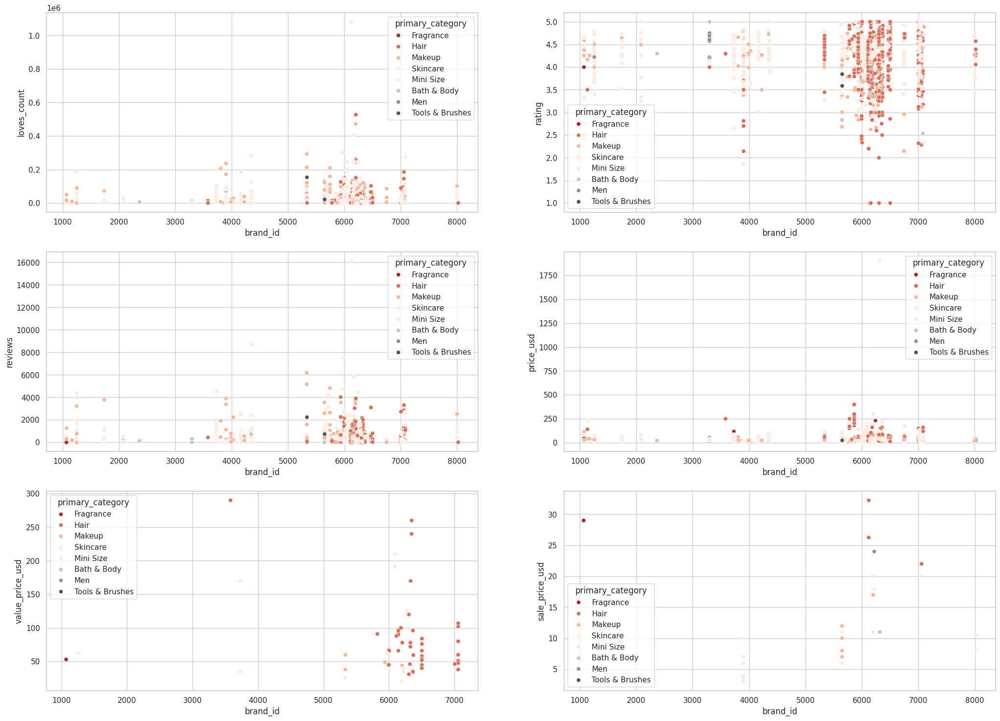

In [190]:
ff = ['loves_count','rating','reviews','price_usd','value_price_usd','sale_price_usd']
fig=plt.figure(figsize=(25,18))
for i,col in enumerate(ff):
    ax=fig.add_subplot(3,2,i+1)
    sns.scatterplot(x='brand_id',y=col,hue='primary_category',data=df,palette="RdGy")

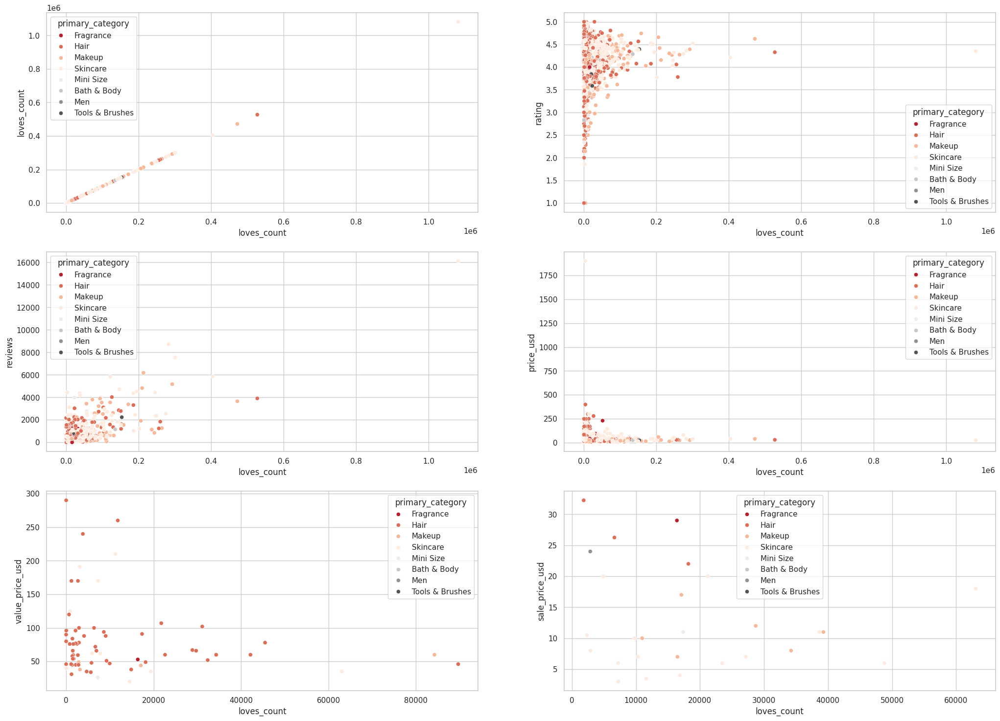

In [191]:
ff = ['loves_count','rating','reviews','price_usd','value_price_usd','sale_price_usd']
fig=plt.figure(figsize=(25,18))
for i,col in enumerate(ff):
    ax=fig.add_subplot(3,2,i+1)
    sns.scatterplot(x='loves_count',y=col,hue='primary_category',data=df,palette="RdGy")

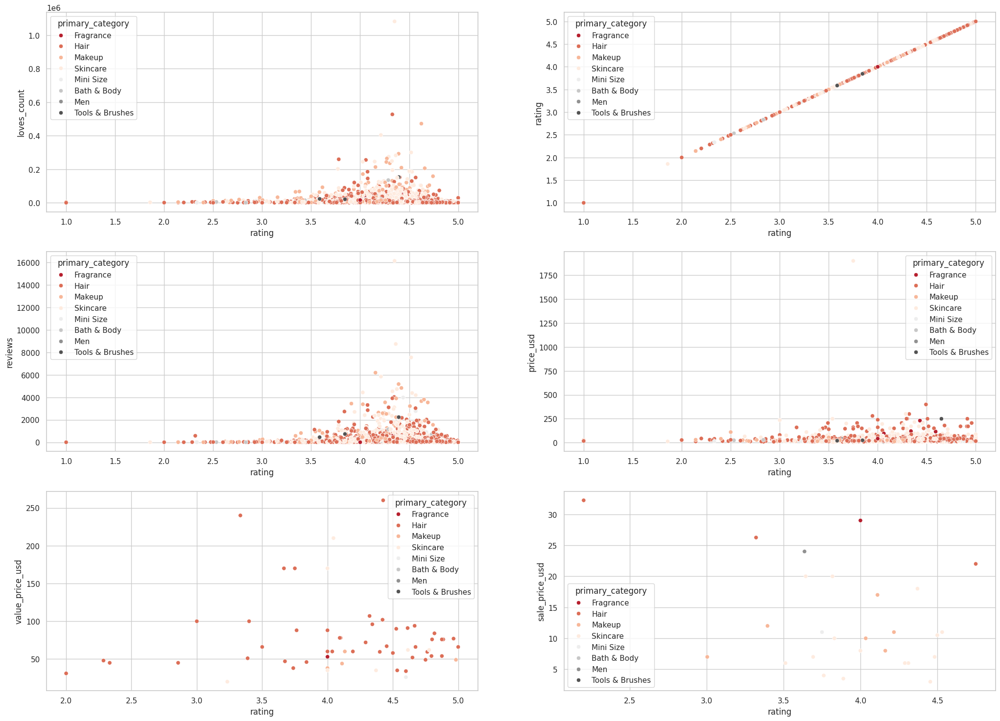

In [192]:
ff = ['loves_count','rating','reviews','price_usd','value_price_usd','sale_price_usd']
fig=plt.figure(figsize=(25,18))
for i,col in enumerate(ff):
    ax=fig.add_subplot(3,2,i+1)
    sns.scatterplot(x='rating',y=col,hue='primary_category',data=df,palette="RdGy")

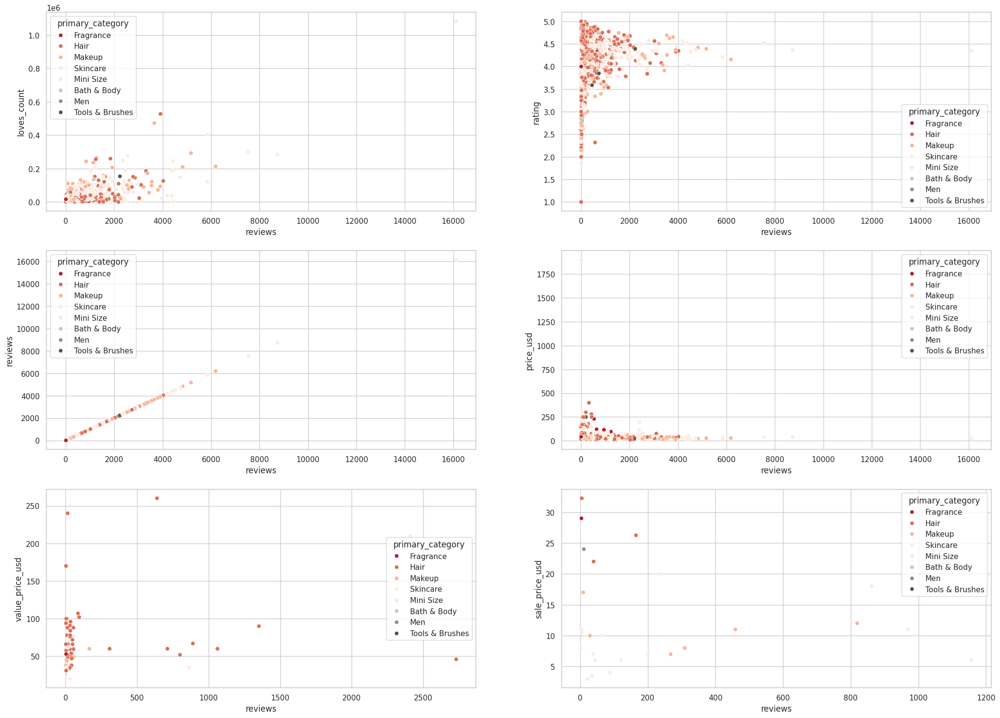

In [193]:
ff = ['loves_count','rating','reviews','price_usd','value_price_usd','sale_price_usd']
fig=plt.figure(figsize=(25,18))
for i,col in enumerate(ff):
    ax=fig.add_subplot(3,2,i+1)
    sns.scatterplot(x='reviews',y=col,hue='primary_category',data=df,palette="RdGy")

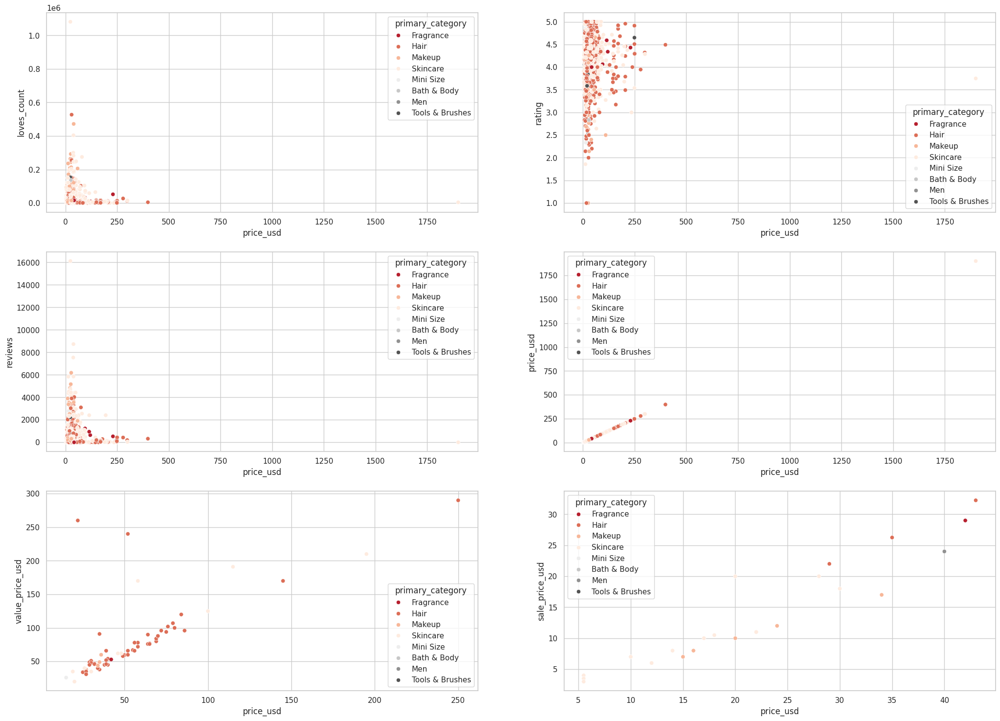

In [194]:
ff = ['loves_count','rating','reviews','price_usd','value_price_usd','sale_price_usd']
fig=plt.figure(figsize=(25,18))
for i,col in enumerate(ff):
    ax=fig.add_subplot(3,2,i+1)
    sns.scatterplot(x='price_usd',y=col,hue='primary_category',data=df,palette="RdGy")

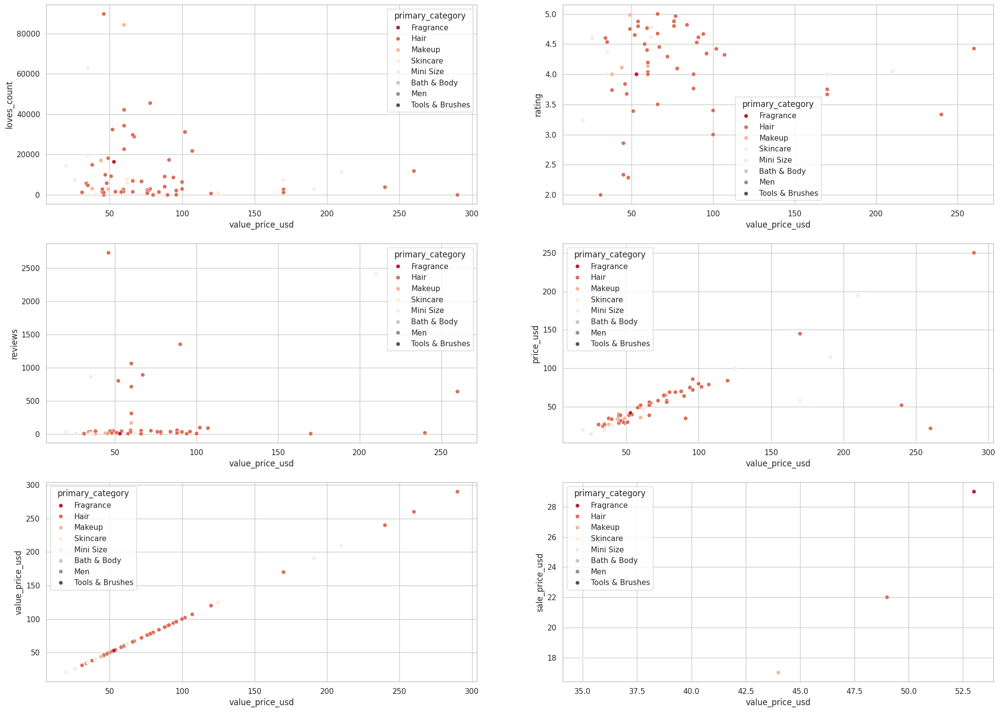

In [195]:
ff = ['loves_count','rating','reviews','price_usd','value_price_usd','sale_price_usd']
fig=plt.figure(figsize=(25,18))
for i,col in enumerate(ff):
    ax=fig.add_subplot(3,2,i+1)
    sns.scatterplot(x='value_price_usd',y=col,hue='primary_category',data=df,palette="RdGy")

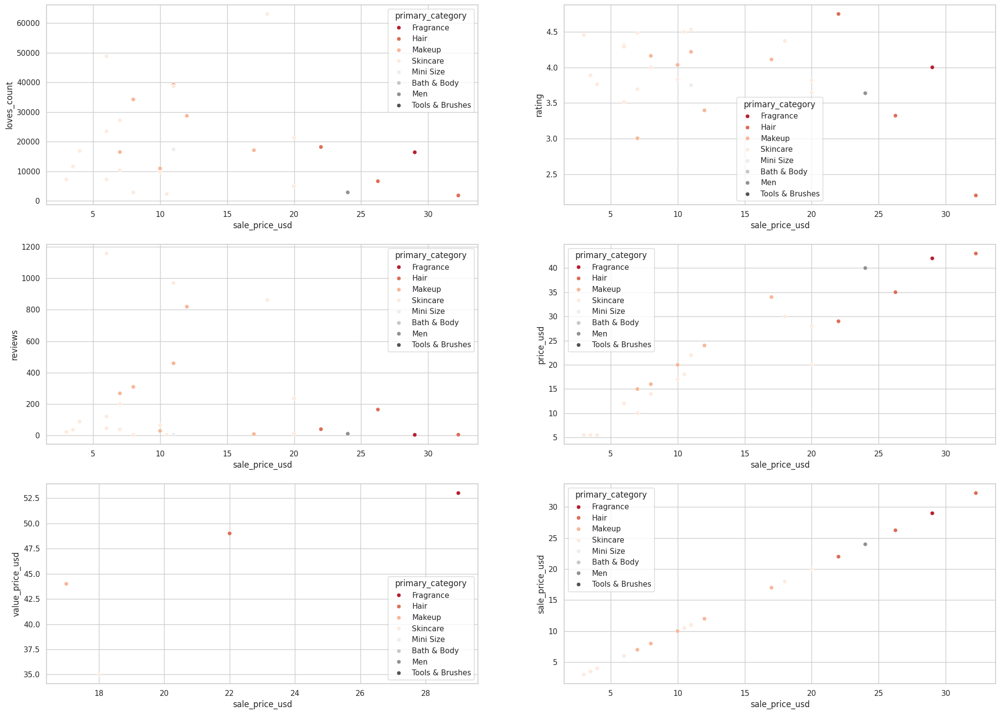

In [196]:
ff = ['loves_count','rating','reviews','price_usd','value_price_usd','sale_price_usd']
fig=plt.figure(figsize=(25,18))
for i,col in enumerate(ff):
    ax=fig.add_subplot(3,2,i+1)
    sns.scatterplot(x='sale_price_usd',y=col,hue='primary_category',data=df,palette="RdGy")

In [197]:
fig = px.scatter_3d(df, x='loves_count', y='rating', z='reviews', color='primary_category', color_continuous_scale="RdGy", template = 'plotly_white')
fig.update_traces(marker=dict(size=5))
fig.show()

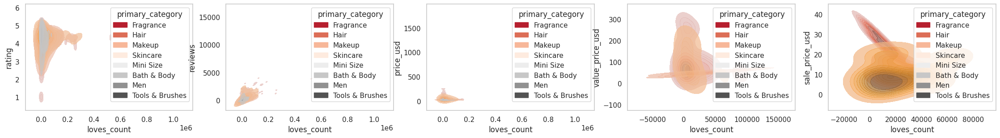

In [198]:
warnings.filterwarnings("ignore")
plt.figure(figsize=(28,18))
plt.subplot(5,5,1)
sns.kdeplot(data=df,x='loves_count', y='rating', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,2)
sns.kdeplot(data=df,x='loves_count', y='reviews', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,3)
sns.kdeplot(data=df,x='loves_count', y='price_usd', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,4)
sns.kdeplot(data=df,x='loves_count', y='value_price_usd', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,5)
sns.kdeplot(data=df,x='loves_count', y='sale_price_usd', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()

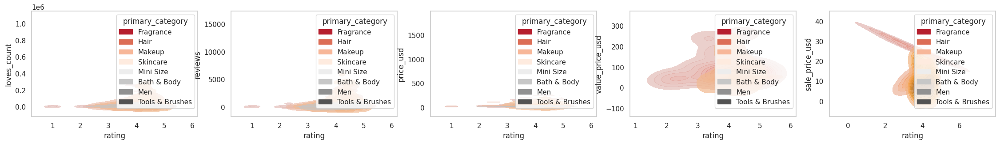

In [199]:
warnings.filterwarnings("ignore")
plt.figure(figsize=(28,18))
plt.subplot(5,5,1)
sns.kdeplot(data=df,x='rating', y='loves_count', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,2)
sns.kdeplot(data=df,x='rating', y='reviews', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,3)
sns.kdeplot(data=df,x='rating', y='price_usd', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,4)
sns.kdeplot(data=df,x='rating', y='value_price_usd', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,5)
sns.kdeplot(data=df,x='rating', y='sale_price_usd', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()

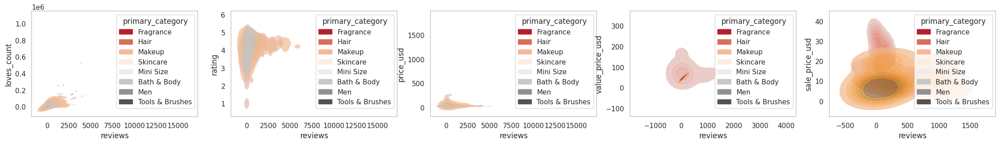

In [200]:
warnings.filterwarnings("ignore")
plt.figure(figsize=(28,18))
plt.subplot(5,5,1)
sns.kdeplot(data=df,x='reviews', y='loves_count', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,2)
sns.kdeplot(data=df,x='reviews', y='rating', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,3)
sns.kdeplot(data=df,x='reviews', y='price_usd', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,4)
sns.kdeplot(data=df,x='reviews', y='value_price_usd', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,5)
sns.kdeplot(data=df,x='reviews', y='sale_price_usd', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()

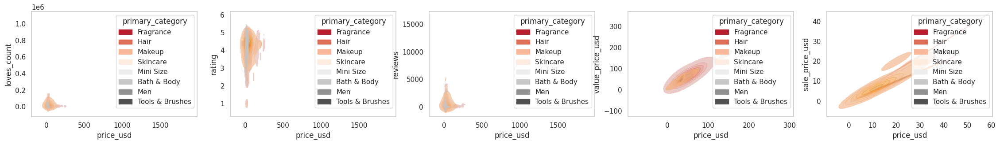

In [201]:
warnings.filterwarnings("ignore")
plt.figure(figsize=(28,18))
plt.subplot(5,5,1)
sns.kdeplot(data=df,x='price_usd', y='loves_count', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,2)
sns.kdeplot(data=df,x='price_usd', y='rating', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,3)
sns.kdeplot(data=df,x='price_usd', y='reviews', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,4)
sns.kdeplot(data=df,x='price_usd', y='value_price_usd', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,5)
sns.kdeplot(data=df,x='price_usd', y='sale_price_usd', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()

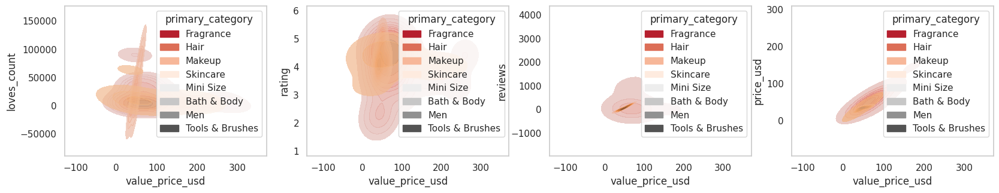

In [202]:
warnings.filterwarnings("ignore")
plt.figure(figsize=(20,15))
plt.subplot(4,4,1)
sns.kdeplot(data=df,x='value_price_usd', y='loves_count', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(4,4,2)
sns.kdeplot(data=df,x='value_price_usd', y='rating', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(4,4,3)
sns.kdeplot(data=df,x='value_price_usd', y='reviews', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(4,4,4)
sns.kdeplot(data=df,x='value_price_usd', y='price_usd', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()

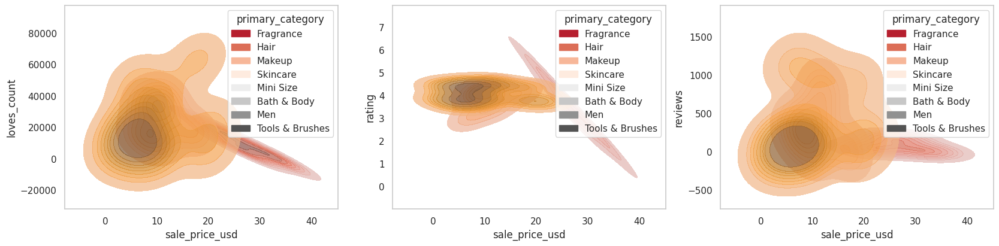

In [203]:
warnings.filterwarnings("ignore")
plt.figure(figsize=(20,15))
plt.subplot(3,3,1)
sns.kdeplot(data=df,x='sale_price_usd', y='loves_count', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(3,3,2)
sns.kdeplot(data=df,x='sale_price_usd', y='rating', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(3,3,3)
sns.kdeplot(data=df,x='sale_price_usd', y='reviews', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()

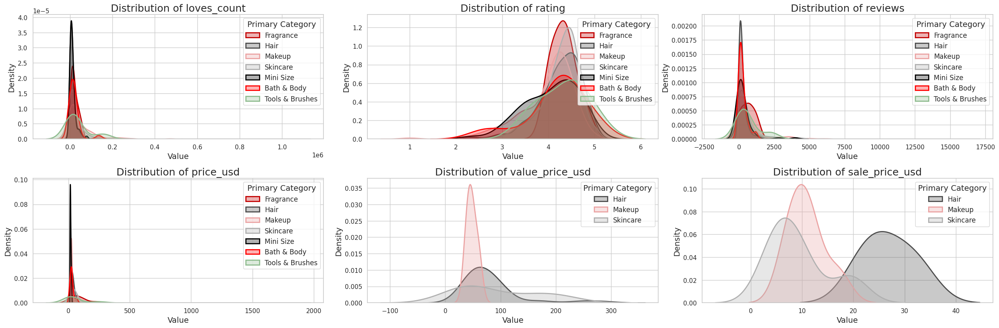

In [204]:
sns.set(style="whitegrid")
fig = plt.figure(figsize=(25, 20))
colors = {
    'Fragrance': '#C20000',
    'Hair': '#4C4C4C',
    'Makeup': '#EBA3A3',
    'Skincare': '#B0B0B0',
    'Mini Size': 'black',
    'Bath & Body': 'red',
    'Tools & Brushes': 'darkseagreen'}
for i, col in enumerate(ff):
    ax = fig.add_subplot(5, 3, i + 1)
    for category, color in colors.items():
        category_data = df[df['primary_category'] == category][col]
        if not category_data.empty:
            sns.kdeplot(
                category_data,
                color=color,
                label=category,
                linewidth=2,
                fill=True,
                alpha=0.3)
    ax.set_title(f'Distribution of {col}', fontsize=18)
    ax.set_xlabel("Value", fontsize=14)
    ax.set_ylabel("Density", fontsize=14)
    ax.legend(title='Primary Category', fontsize=12, title_fontsize=14)
plt.tight_layout()
plt.show()

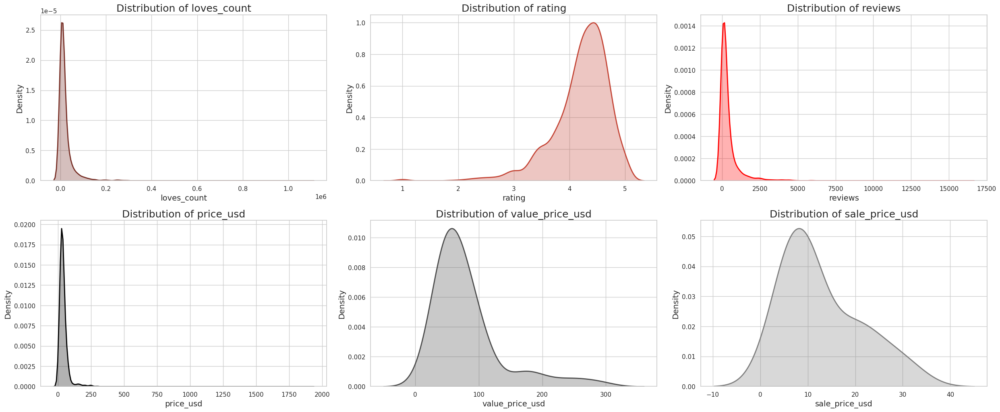

In [205]:
warnings.filterwarnings("ignore")
plt.figure(figsize=(25, 15))
colors = {
    'loves_count': '#772E25',
    'rating': '#C44536',
    'reviews': 'red',
    'price_usd': '#000000',
    'value_price_usd': '#4C4C4C',
    'sale_price_usd': '#7F7F7F'}
features = ['loves_count', 'rating', 'reviews', 'price_usd', 'value_price_usd', 'sale_price_usd']
for i, feature in enumerate(features):
    ax = plt.subplot(3, 3, i + 1)
    sns.kdeplot(df[feature], color=colors[feature], linewidth=2, fill=True, alpha=0.3)
    ax.set_title(f'Distribution of {feature}', fontsize=18)
    ax.set_xlabel(feature, fontsize=14)
    ax.set_ylabel('Density', fontsize=14)
plt.tight_layout()
plt.show()

In [206]:
# measure of skewness
df[ff].skew(axis = 0, skipna = True)

,0
loves_count,10.104482
rating,-1.585977
reviews,7.260202
price_usd,22.253801
value_price_usd,2.107245
sale_price_usd,0.910900


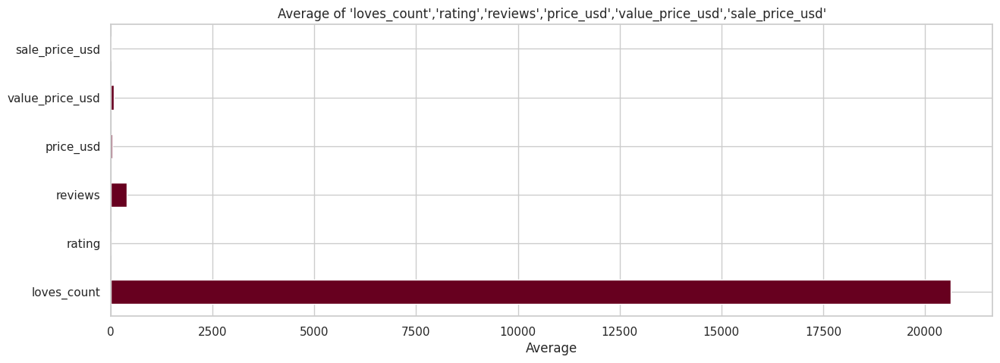

In [207]:
df_mean = df[ff].mean()
df_mean.plot(kind='barh', stacked=True, figsize=(15, 5), cmap="RdGy")
plt.xlabel('Average')
plt.title("Average of 'loves_count','rating','reviews','price_usd','value_price_usd','sale_price_usd'")
plt.show()

<Axes: >

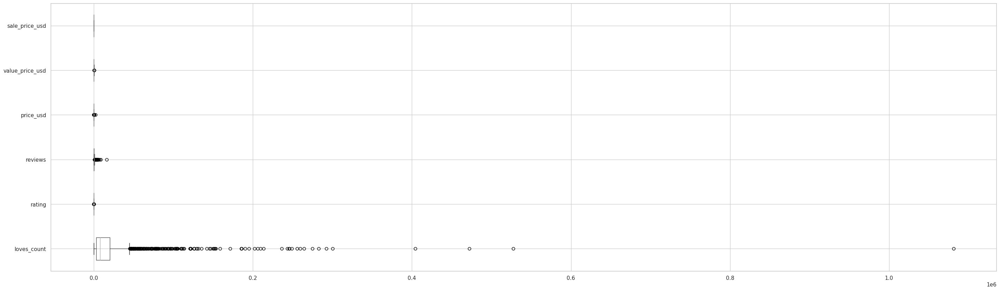

In [208]:
df[ff].boxplot(figsize=(35,10),vert=False)

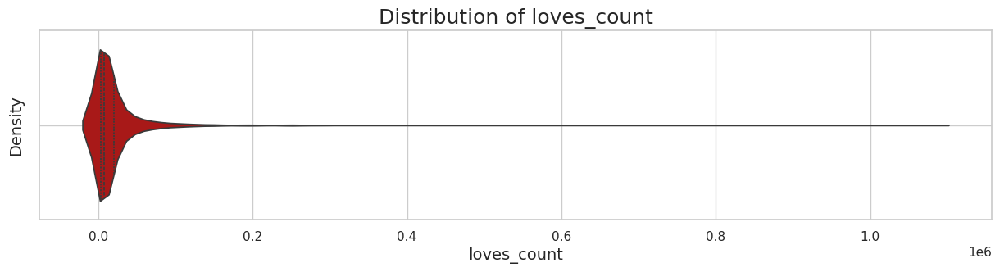

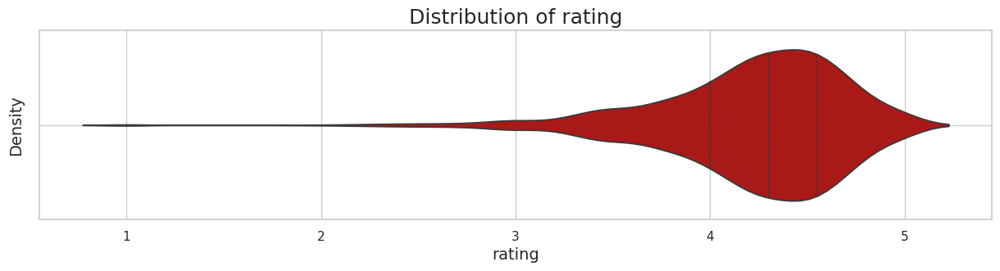

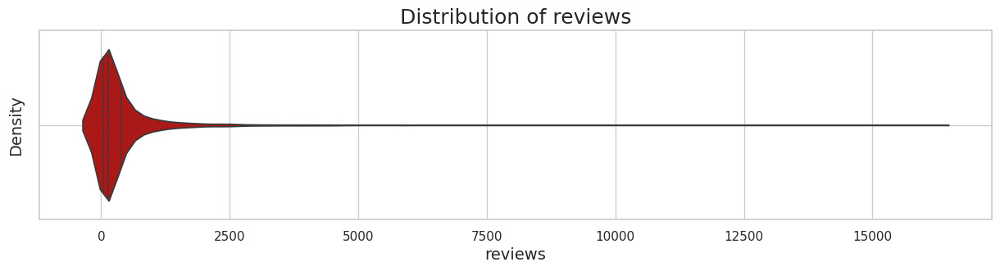

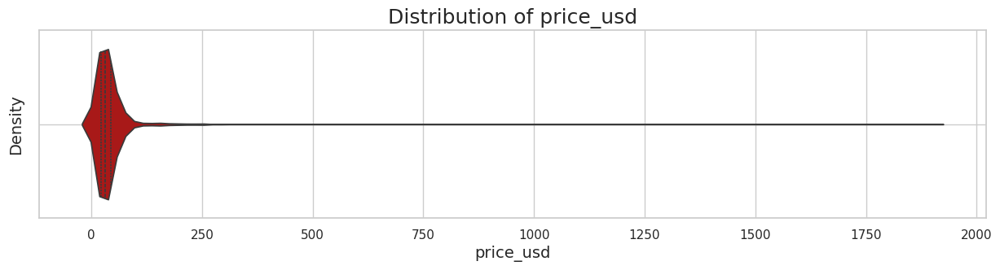

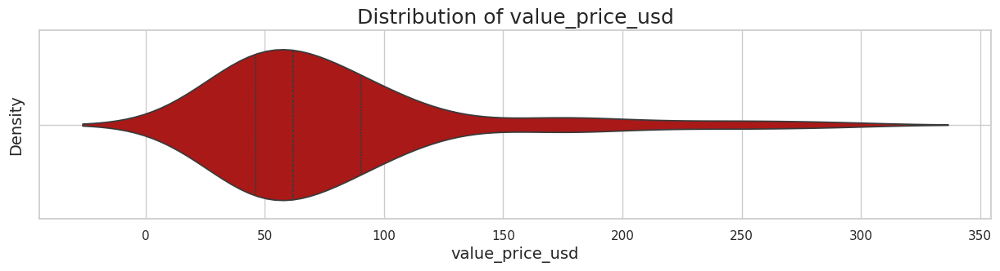

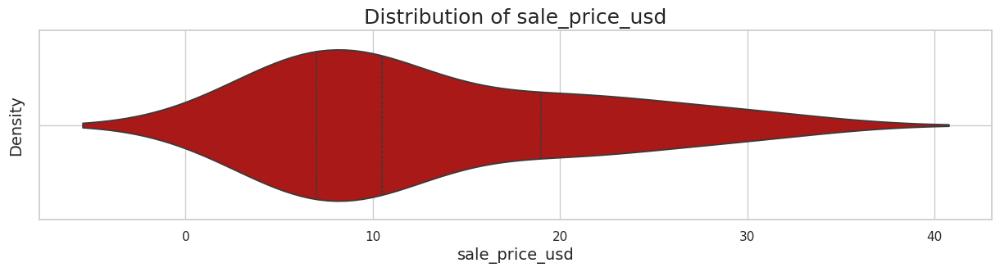

In [209]:
palette = "gist_heat"
for column in ff:
    plt.figure(figsize=(15, 3))
    sns.violinplot(x=df[column], palette=palette, inner="quartile")
    plt.title(f'Distribution of {column}', fontsize=18)
    plt.xlabel(column, fontsize=14)
    plt.ylabel('Density', fontsize=14)
    plt.grid(True)
    plt.show()

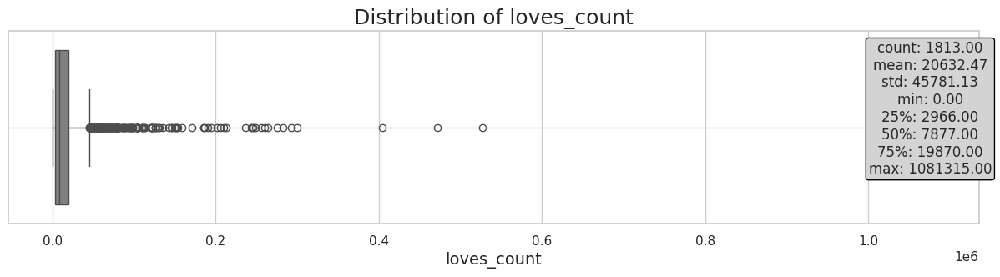

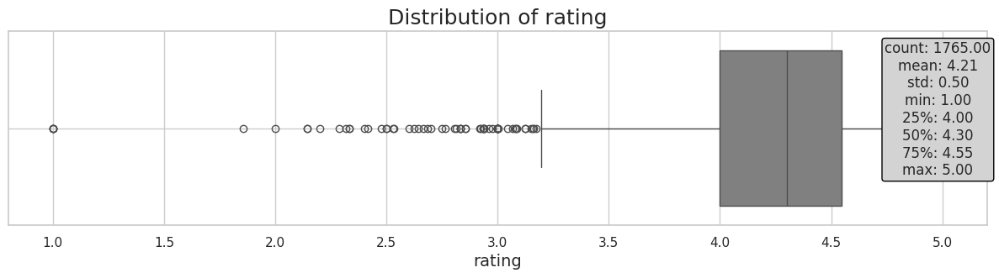

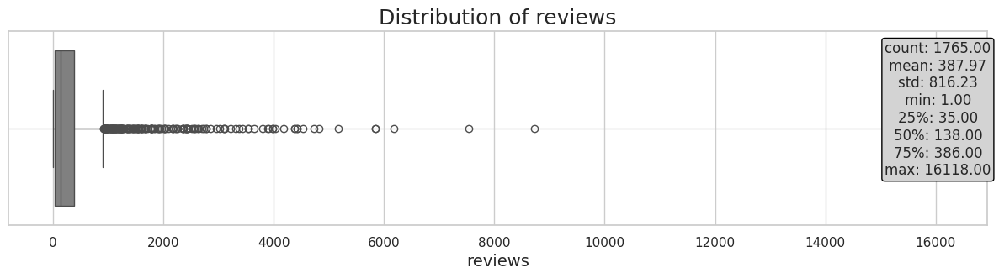

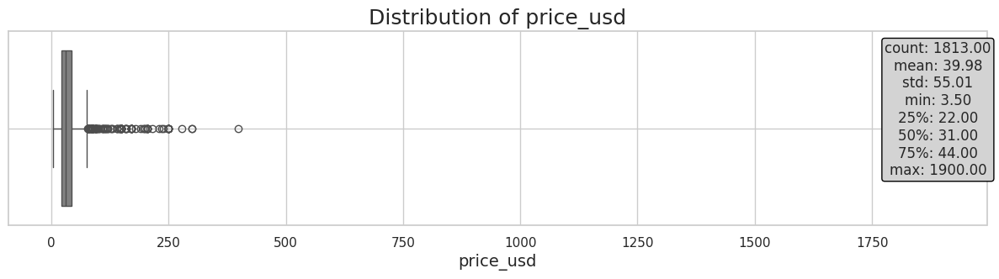

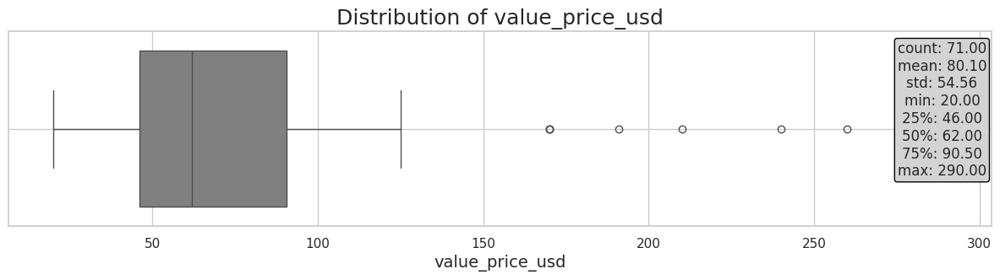

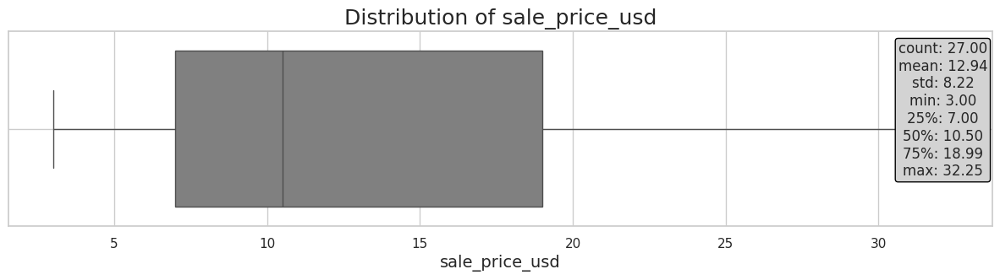

In [210]:
palette = "gray"
for column in ff:
    plt.figure(figsize=(15, 3))
    sns.boxplot(x=df[column], palette=palette)
    plt.title(f'Distribution of {column}', fontsize=18)
    plt.xlabel(column, fontsize=14)
    stats = df[column].describe()
    stats_text = "\n".join([f"{key}: {value:.2f}" for key, value in stats.items()])
    plt.text(0.95, 0.95, stats_text, transform=plt.gca().transAxes,
             fontsize=12, verticalalignment='top',
             horizontalalignment='center', bbox=dict(boxstyle='round,pad=0.2', edgecolor='black', facecolor='lightgrey'))
    plt.grid(True)
    plt.show()

In [211]:
def StDev_method (df,n,features):
    outliers = []
    for column in features:
        data_mean = df[column].mean()
        data_std = df[column].std()
        cut_off = data_std * 3
        outlier_list_column = df[(df[column] < data_mean - cut_off) | (df[column] > data_mean + cut_off)].index
        outliers.extend(outlier_list_column)
    outliers = Counter(outliers)
    OUT= list( k for k, v in outliers.items() if v > n )
    df1 = df[df[column] > data_mean + cut_off]
    df2 = df[df[column] < data_mean - cut_off]
    print('Total number of outliers is:', df1.shape[0]+ df2.shape[0])

    return OUT
Outliers_StDev = StDev_method(df,1,ff)
df_out2 = df.drop(Outliers_StDev, axis = 0).reset_index(drop=True)

Total number of outliers is: 0


<Figure size 2700x720 with 0 Axes>

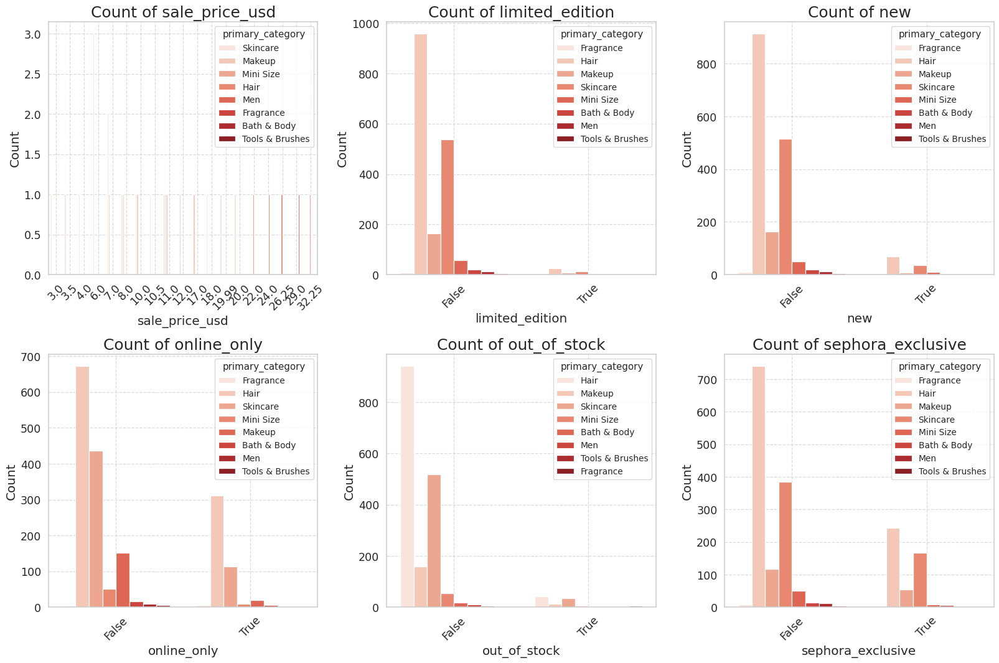

In [212]:
# List of variables for count plots
count_vars = [
    'sale_price_usd',
    'limited_edition',
    'new',
    'online_only',
    'out_of_stock',
    'sephora_exclusive', ]
# General figure settings
plt.figure(figsize=(30, 8), dpi=90)
# Create a grid of subplots
n_cols = 3  # Number of columns
n_rows = (len(count_vars) + n_cols - 1) // n_cols  # Number of rows
fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 12), dpi=90)
axes = axes.flatten()  # Convert to a 1D array for easy access
palette = "Reds"
# Loop to create count plots
for i, column in enumerate(count_vars):
    sns.countplot(x=column, data=df, palette=palette, hue='primary_category', ax=axes[i])
    axes[i].set_title(f'Count of {column}', fontsize=20)
    axes[i].set_xlabel(column, fontsize=16)
    axes[i].set_ylabel('Count', fontsize=16)
    axes[i].tick_params(axis='x', rotation=45, labelsize=14)
    axes[i].tick_params(axis='y', labelsize=14)
    axes[i].grid(True, linestyle='--', alpha=0.7)
# Remove extra subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

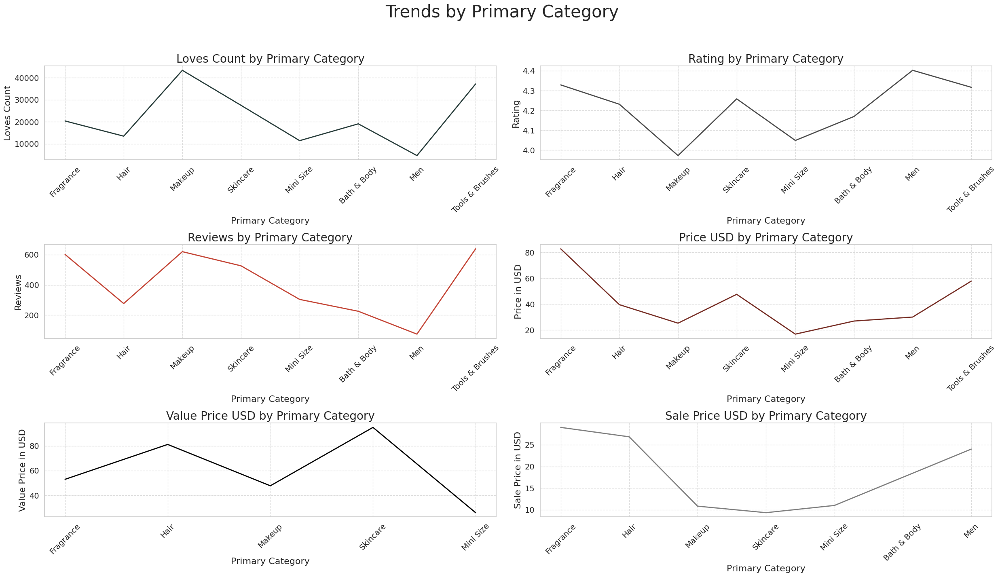

In [213]:
fig, axes = plt.subplots(3, 2, figsize=(25, 15))
fig.suptitle('Trends by Primary Category', fontsize=30)
sns.lineplot(ax=axes[0, 0], x='primary_category', y='loves_count', data=df, ci=None, color='#283D3B', linewidth=2)
axes[0, 0].set_title('Loves Count by Primary Category', fontsize=20)
axes[0, 0].set_xlabel('Primary Category', fontsize=16)
axes[0, 0].set_ylabel('Loves Count', fontsize=16)
sns.lineplot(ax=axes[0, 1], x='primary_category', y='rating', data=df, ci=None, color='#4C4C4C', linewidth=2)
axes[0, 1].set_title('Rating by Primary Category', fontsize=20)
axes[0, 1].set_xlabel('Primary Category', fontsize=16)
axes[0, 1].set_ylabel('Rating', fontsize=16)
sns.lineplot(ax=axes[1, 0], x='primary_category', y='reviews', data=df, ci=None, color='#C44536', linewidth=2)
axes[1, 0].set_title('Reviews by Primary Category', fontsize=20)
axes[1, 0].set_xlabel('Primary Category', fontsize=16)
axes[1, 0].set_ylabel('Reviews', fontsize=16)
sns.lineplot(ax=axes[1, 1], x='primary_category', y='price_usd', data=df, ci=None, color='#772E25', linewidth=2)
axes[1, 1].set_title('Price USD by Primary Category', fontsize=20)
axes[1, 1].set_xlabel('Primary Category', fontsize=16)
axes[1, 1].set_ylabel('Price in USD', fontsize=16)
sns.lineplot(ax=axes[2, 0], x='primary_category', y='value_price_usd', data=df, ci=None, color='#000000', linewidth=2)
axes[2, 0].set_title('Value Price USD by Primary Category', fontsize=20)
axes[2, 0].set_xlabel('Primary Category', fontsize=16)
axes[2, 0].set_ylabel('Value Price in USD', fontsize=16)
sns.lineplot(ax=axes[2, 1], x='primary_category', y='sale_price_usd', data=df, ci=None, color='#7F7F7F', linewidth=2)
axes[2, 1].set_title('Sale Price USD by Primary Category', fontsize=20)
axes[2, 1].set_xlabel('Primary Category', fontsize=16)
axes[2, 1].set_ylabel('Sale Price in USD', fontsize=16)
for ax in axes.flat:
    ax.grid(True, linestyle='--', alpha=0.7)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, fontsize=14)
    ax.tick_params(axis='y', labelsize=14)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

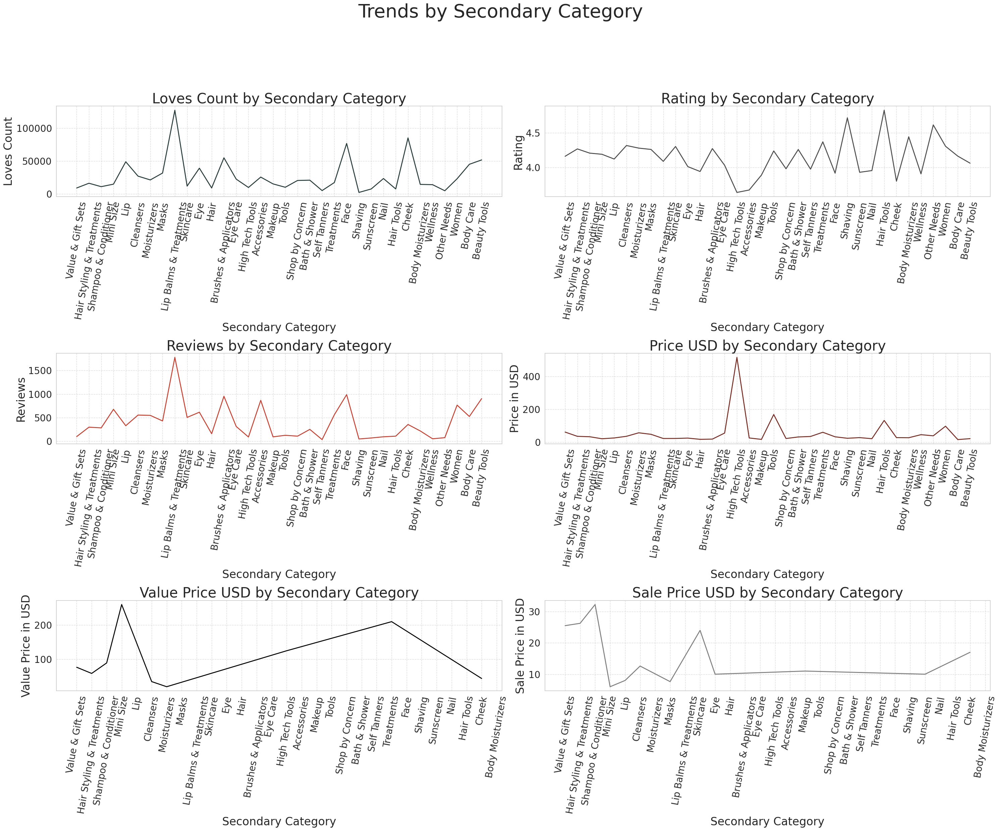

In [214]:
fig, axes = plt.subplots(3, 2, figsize=(30, 25))
fig.suptitle('Trends by Secondary Category', fontsize=40, y=1.02)
sns.lineplot(ax=axes[0, 0], x='secondary_category', y='loves_count', data=df, ci=None, color='#283D3B', linewidth=2)
axes[0, 0].set_title('Loves Count by Secondary Category', fontsize=30)
axes[0, 0].set_xlabel('Secondary Category', fontsize=24)
axes[0, 0].set_ylabel('Loves Count', fontsize=24)
sns.lineplot(ax=axes[0, 1], x='secondary_category', y='rating', data=df, ci=None, color='#4C4C4C', linewidth=2)
axes[0, 1].set_title('Rating by Secondary Category', fontsize=30)
axes[0, 1].set_xlabel('Secondary Category', fontsize=24)
axes[0, 1].set_ylabel('Rating', fontsize=24)
sns.lineplot(ax=axes[1, 0], x='secondary_category', y='reviews', data=df, ci=None, color='#C44536', linewidth=2)
axes[1, 0].set_title('Reviews by Secondary Category', fontsize=30)
axes[1, 0].set_xlabel('Secondary Category', fontsize=24)
axes[1, 0].set_ylabel('Reviews', fontsize=24)
sns.lineplot(ax=axes[1, 1], x='secondary_category', y='price_usd', data=df, ci=None, color='#772E25', linewidth=2)
axes[1, 1].set_title('Price USD by Secondary Category', fontsize=30)
axes[1, 1].set_xlabel('Secondary Category', fontsize=24)
axes[1, 1].set_ylabel('Price in USD', fontsize=24)
sns.lineplot(ax=axes[2, 0], x='secondary_category', y='value_price_usd', data=df, ci=None, color='#000000', linewidth=2)
axes[2, 0].set_title('Value Price USD by Secondary Category', fontsize=30)
axes[2, 0].set_xlabel('Secondary Category', fontsize=24)
axes[2, 0].set_ylabel('Value Price in USD', fontsize=24)
sns.lineplot(ax=axes[2, 1], x='secondary_category', y='sale_price_usd', data=df, ci=None, color='#7F7F7F', linewidth=2)
axes[2, 1].set_title('Sale Price USD by Secondary Category', fontsize=30)
axes[2, 1].set_xlabel('Secondary Category', fontsize=24)
axes[2, 1].set_ylabel('Sale Price in USD', fontsize=24)
for ax in axes.flat:
    ax.grid(True, linestyle='--', alpha=0.7)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=80, fontsize=20)
    ax.tick_params(axis='y', labelsize=20)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

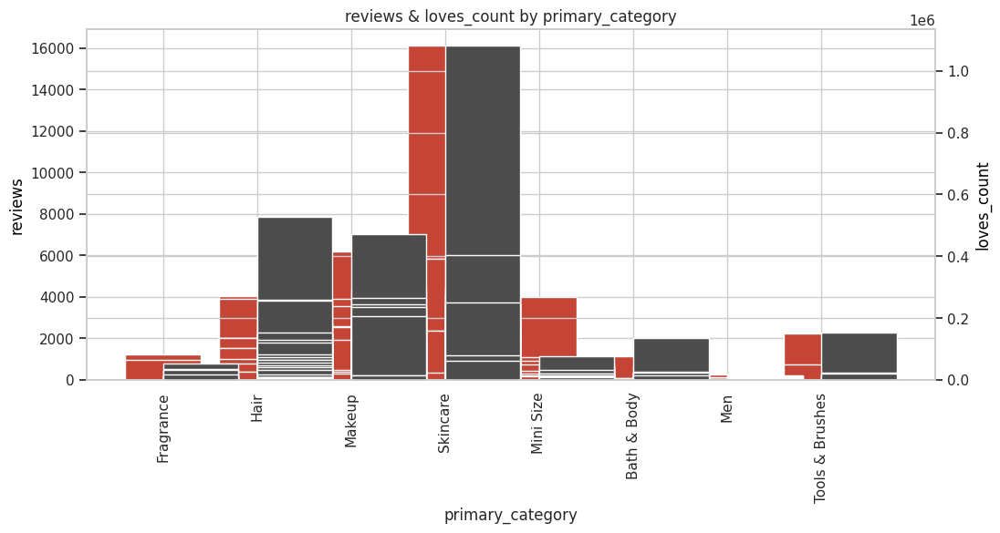

In [215]:
fig, ax1 = plt.subplots(figsize=(12,5))
ax1.bar(df['primary_category'], df['reviews'], color='#C44536', align='center')
ax1.set_ylabel('reviews', color='#000000')
plt.xticks(rotation=90)
plt.xlabel('primary_category')
ax2 = ax1.twinx()
ax2.bar(df['primary_category'], df['loves_count'], color='#4C4C4C', align='edge')
ax2.set_ylabel('loves_count', color='#000000')
plt.title('reviews & loves_count by primary_category')
plt.show()

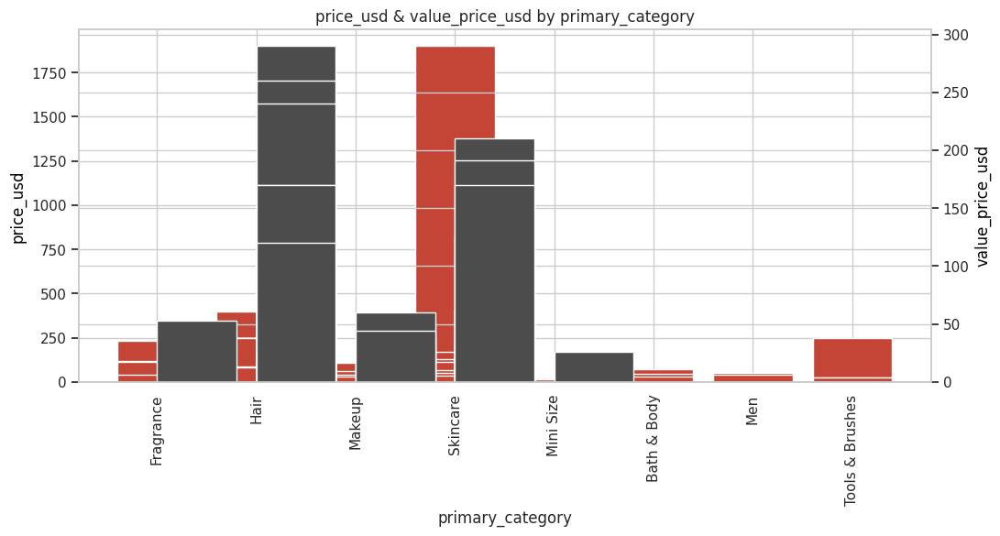

In [216]:
fig, ax1 = plt.subplots(figsize=(12,5))
ax1.bar(df['primary_category'], df['price_usd'], color='#C44536', align='center')
ax1.set_ylabel('price_usd', color='#000000')
plt.xticks(rotation=90)
plt.xlabel('primary_category')
ax2 = ax1.twinx()
ax2.bar(df['primary_category'], df['value_price_usd'], color='#4C4C4C', align='edge')
ax2.set_ylabel('value_price_usd', color='#000000')
plt.title('price_usd & value_price_usd by primary_category')
plt.show()

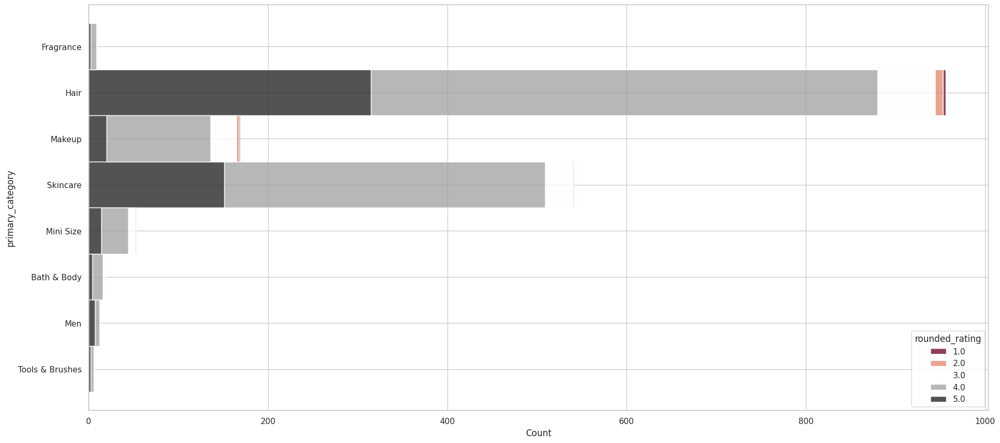

In [217]:
plt.figure(figsize=(22, 10))
sns.histplot(df5, y="primary_category",palette='RdGy',hue="rounded_rating", multiple="stack")
plt.show()

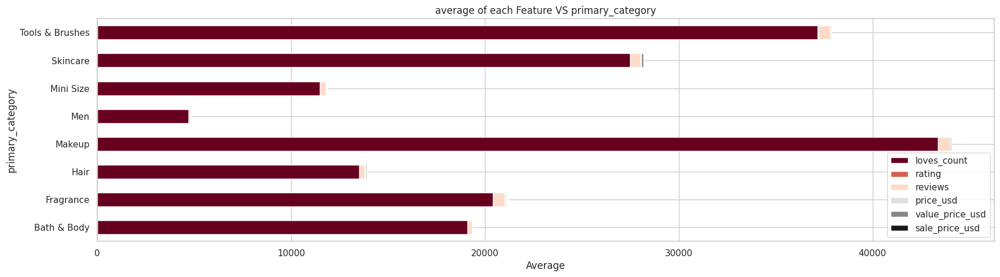

In [218]:
df_mean = df.groupby('primary_category')[ff].mean()
df_mean.plot(kind='barh', stacked=True, figsize=(20, 5), cmap="RdGy")
plt.xlabel('Average')
plt.title('average of each Feature VS primary_category')
plt.legend(loc='lower right')
plt.show()

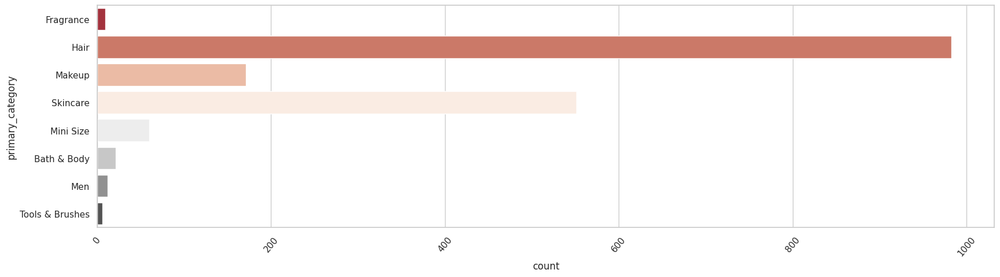

In [219]:
ww = df["primary_category"]
plt.figure(figsize=(20, 5))
plt.xticks(rotation=50)
sns.countplot(y=ww,palette='RdGy')
plt.show()

In [220]:
df.primary_category.value_counts()

,count
primary_category,
Hair,983
Skincare,551
Makeup,171
Mini Size,60
Bath & Body,21
Men,12
Fragrance,9
Tools & Brushes,6


In [221]:
df.secondary_category.value_counts()

,count
secondary_category,
Hair Styling & Treatments,458
Shampoo & Conditioner,421
Cleansers,167
Masks,162
Eye,88
Moisturizers,79
Value & Gift Sets,70
Mini Size,58
Hair,38


In [222]:
df.tertiary_category.value_counts()

,count
tertiary_category,
Shampoo,233
Conditioner,188
Face Wash & Cleansers,156
Face Masks,131
Hair Styling Products,129
...,...
Tinted Moisturizer,1
Decollete & Neck Creams,1
Face Primer,1


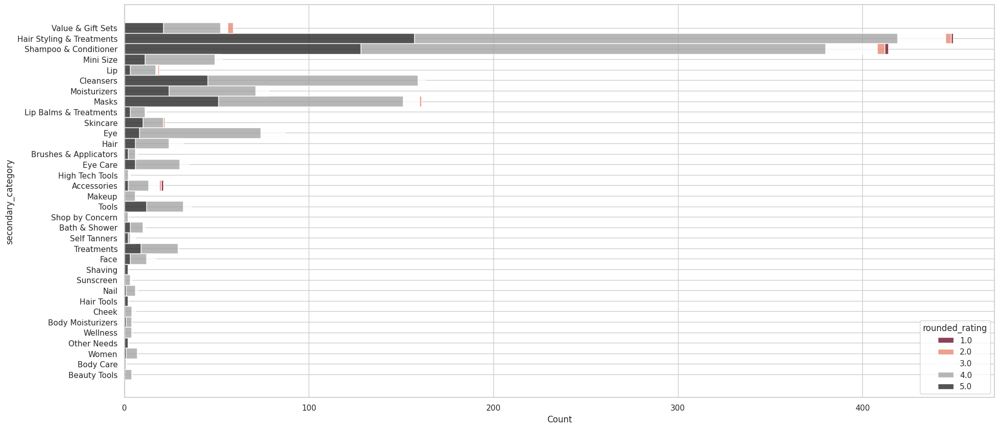

In [223]:
plt.figure(figsize=(22, 10))
sns.histplot(df5, y="secondary_category",palette='RdGy',hue="rounded_rating", multiple="stack")
plt.show()

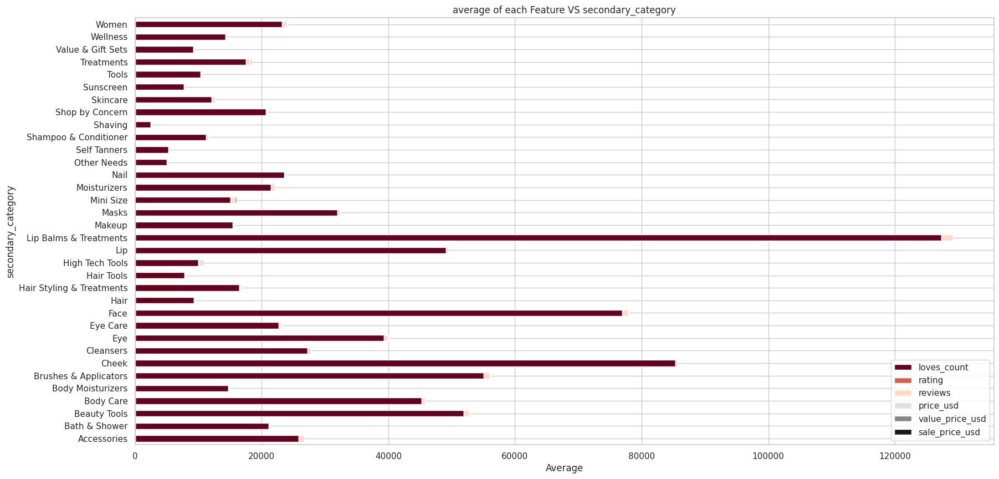

In [224]:
df_mean = df.groupby('secondary_category')[ff].mean()
df_mean.plot(kind='barh', stacked=True, figsize=(20, 10), cmap="RdGy")
plt.xlabel('Average')
plt.title('average of each Feature VS secondary_category')
plt.legend(loc='lower right')
plt.show()

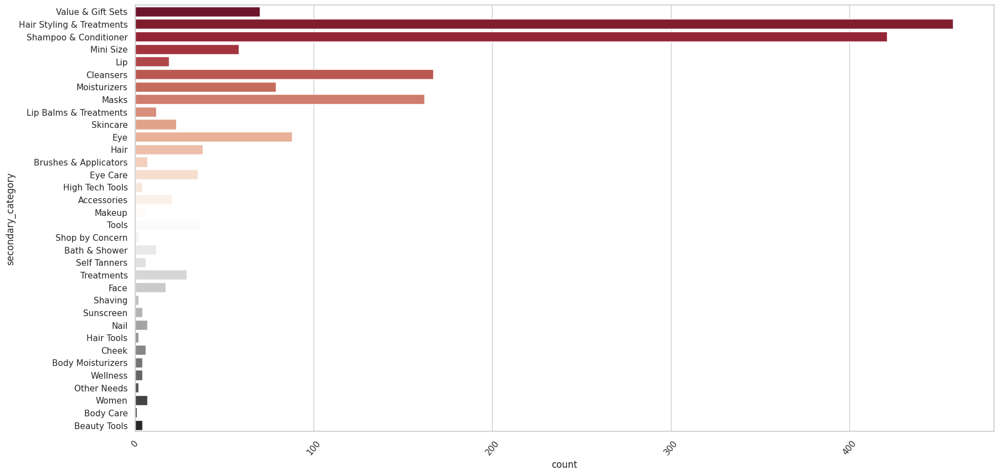

In [225]:
ww = df["secondary_category"]
plt.figure(figsize=(20, 10))
plt.xticks(rotation=50)
sns.countplot(y=ww,palette='RdGy')
plt.show()

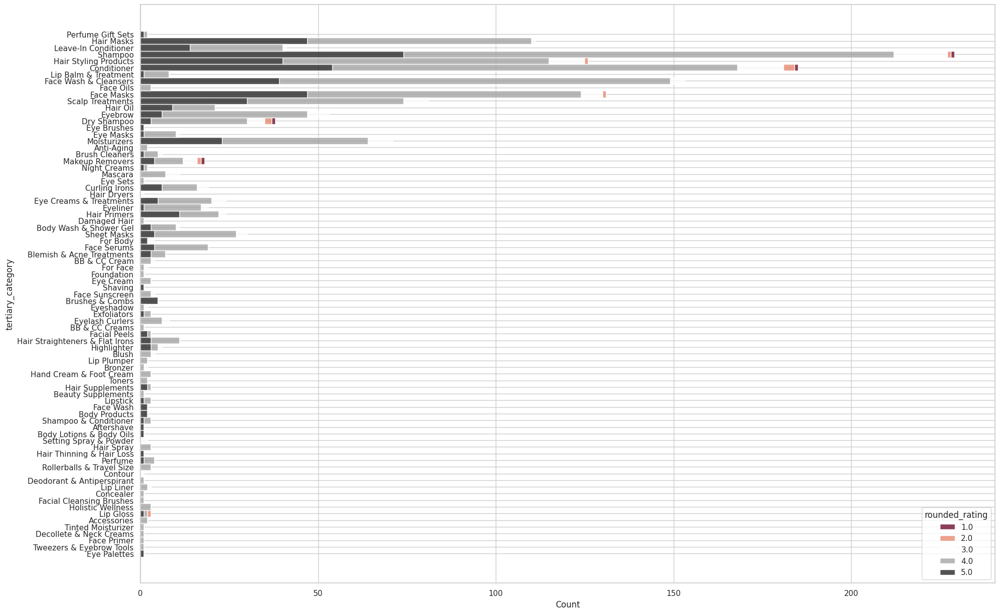

In [226]:
plt.figure(figsize=(22, 15))
sns.histplot(df5, y="tertiary_category",palette='RdGy',hue="rounded_rating", multiple="stack")
plt.show()

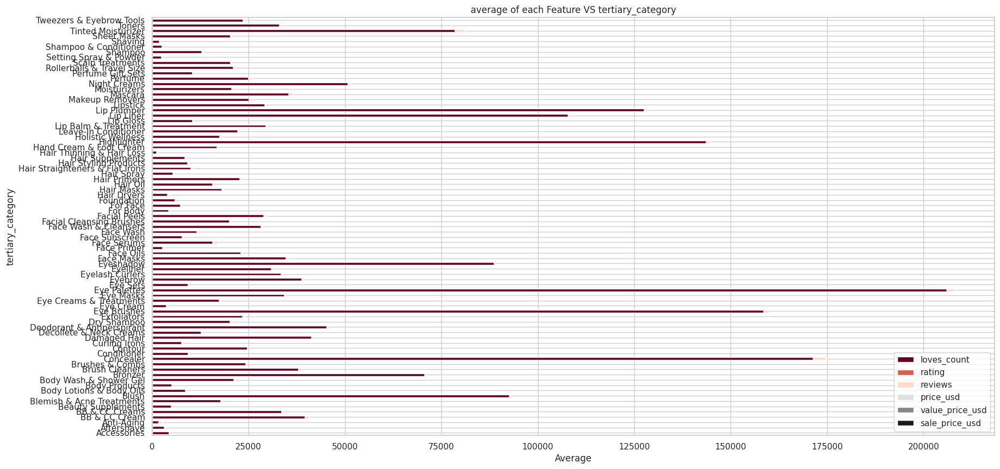

In [227]:
df_mean = df.groupby('tertiary_category')[ff].mean()
df_mean.plot(kind='barh', stacked=True, figsize=(20, 10), cmap="RdGy")
plt.xlabel('Average')
plt.title('average of each Feature VS tertiary_category')
plt.legend(loc='lower right')
plt.show()

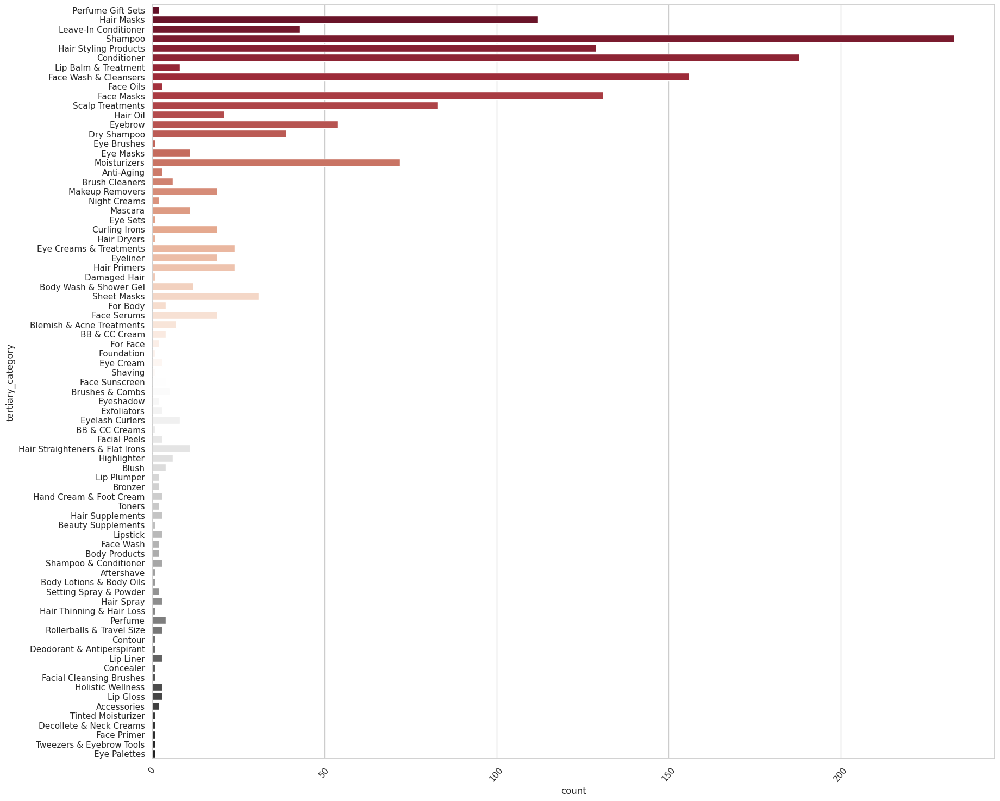

In [228]:
ww = df["tertiary_category"]
plt.figure(figsize=(20, 18))
plt.xticks(rotation=50)
sns.countplot(y=ww,palette='RdGy')
plt.show()

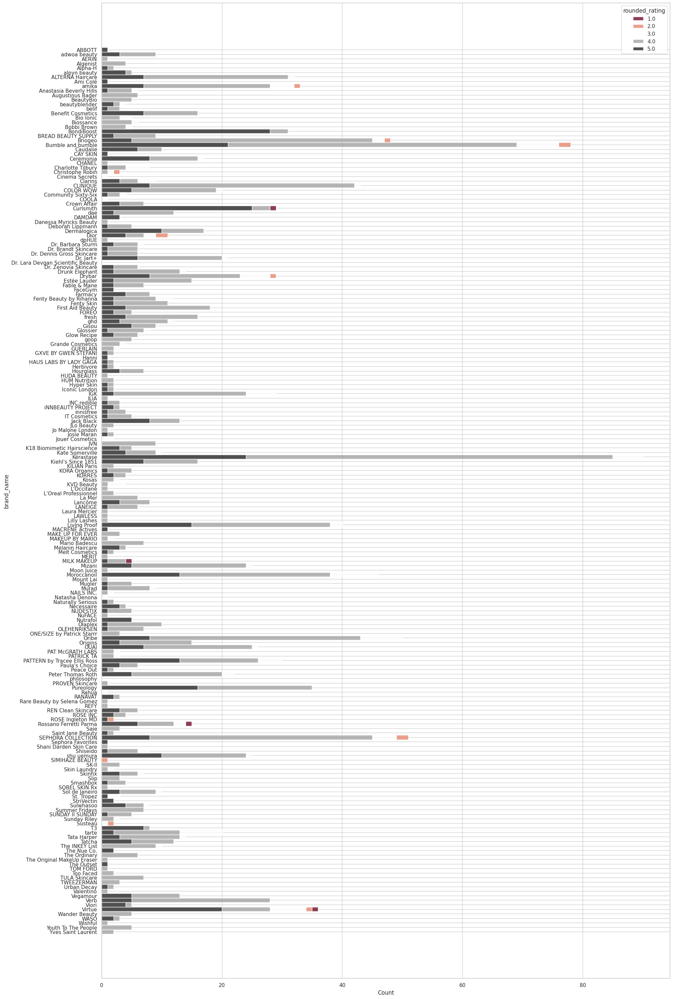

In [229]:
plt.figure(figsize=(22, 38))
sns.histplot(df5, y="brand_name",palette='RdGy',hue="rounded_rating", multiple="stack")
plt.show()

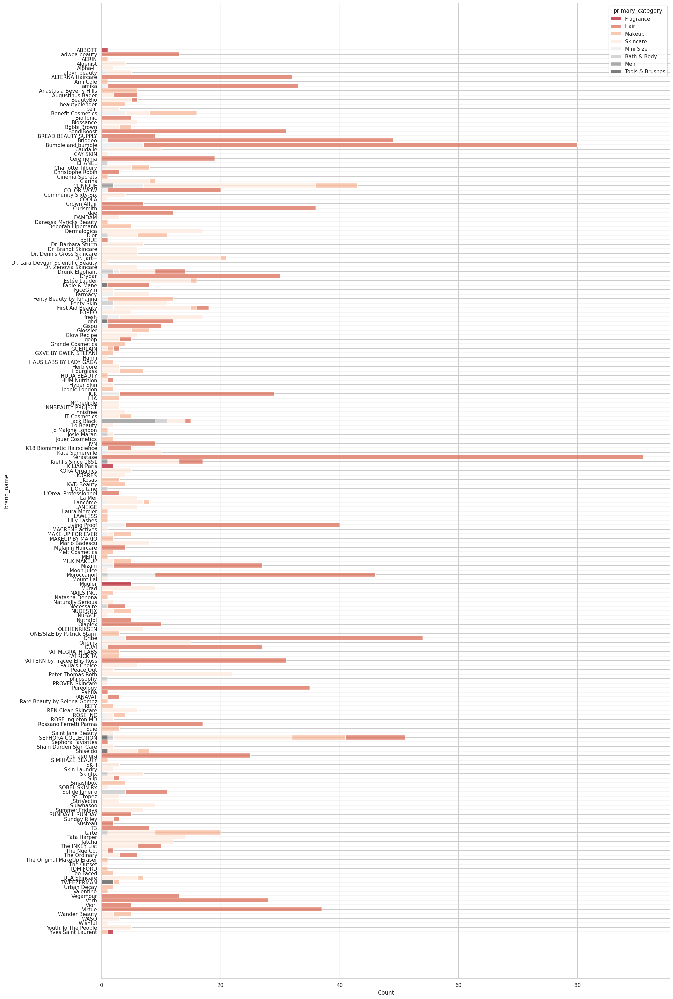

In [230]:
plt.figure(figsize=(22, 38))
sns.histplot(df, y="brand_name",palette='RdGy',hue="primary_category", multiple="stack")
plt.show()

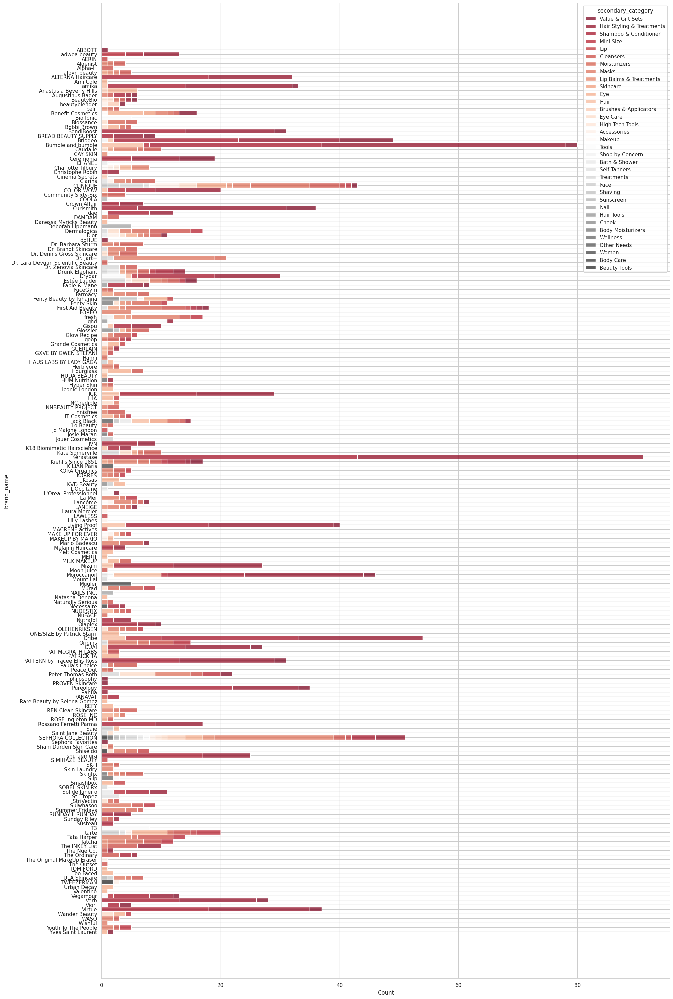

In [231]:
plt.figure(figsize=(22, 38))
sns.histplot(df, y="brand_name",palette='RdGy',hue="secondary_category", multiple="stack")
plt.show()

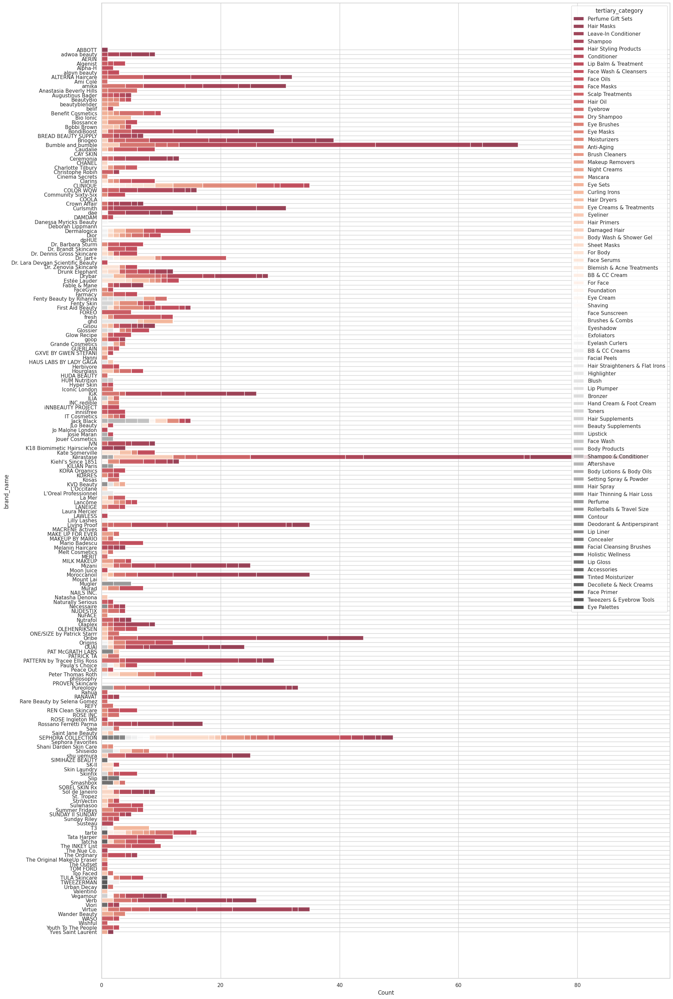

In [232]:
plt.figure(figsize=(22, 38))
sns.histplot(df, y="brand_name",palette='RdGy',hue="tertiary_category", multiple="stack")
plt.show()

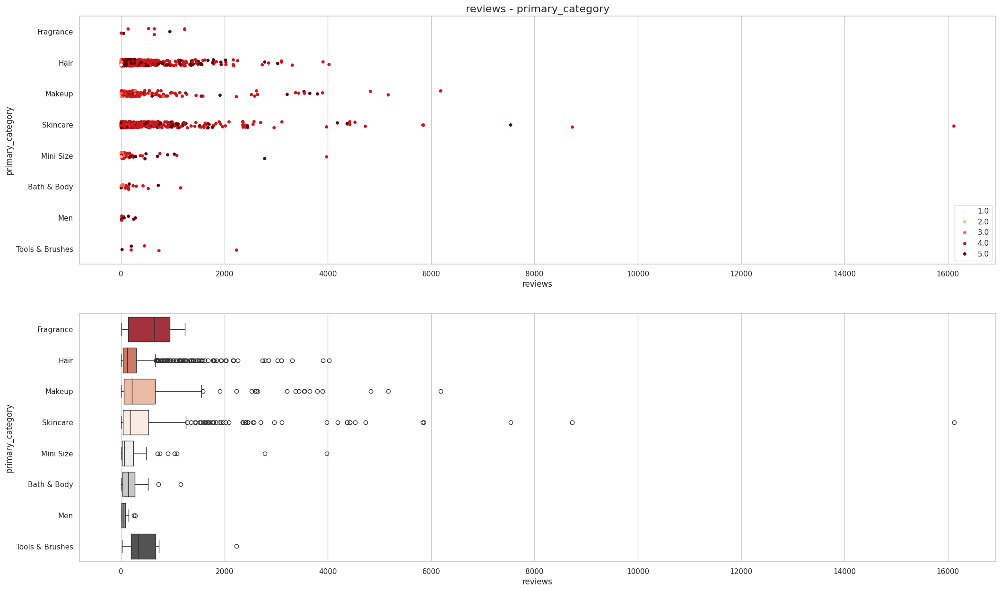

In [233]:
fig, axes = plt.subplots(2,1, figsize=(25,15))
sns.stripplot(data=df5, x='reviews', palette='Reds', hue='rounded_rating', y='primary_category', orient='h', ax=axes[0])
axes[0].set_title('reviews - primary_category', fontsize='16')
axes[0].legend(loc=4)
sns.boxplot(data=df5, x='reviews', palette='RdGy', y='primary_category', orient='h', ax=axes[1])
plt.show()

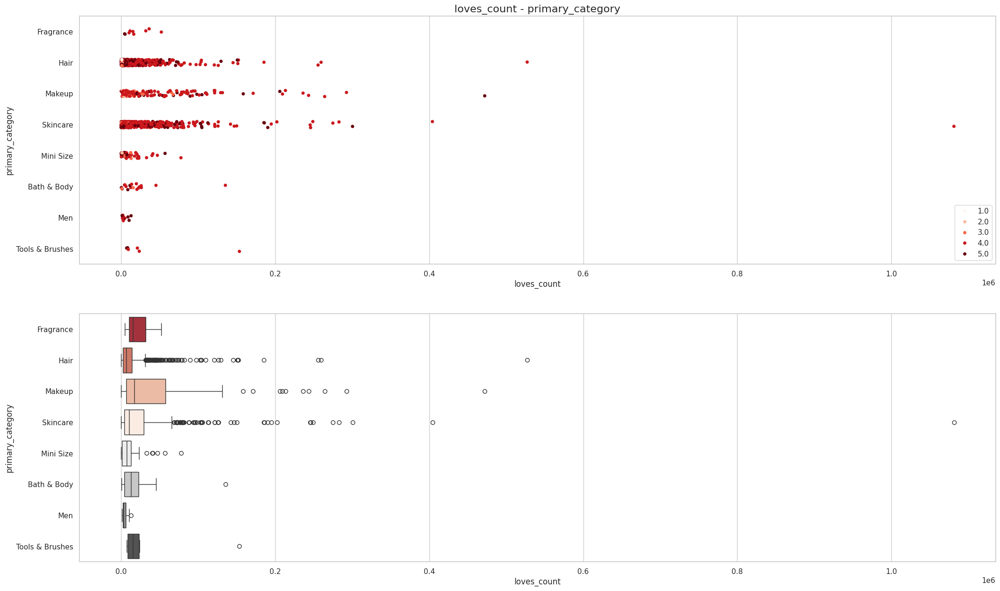

In [234]:
fig, axes = plt.subplots(2,1, figsize=(25,15))
sns.stripplot(data=df5, x='loves_count', palette='Reds', hue='rounded_rating', y='primary_category', orient='h', ax=axes[0])
axes[0].set_title('loves_count - primary_category', fontsize='16')
axes[0].legend(loc=4)
sns.boxplot(data=df5, x='loves_count', palette='RdGy', y='primary_category', orient='h', ax=axes[1])
plt.show()

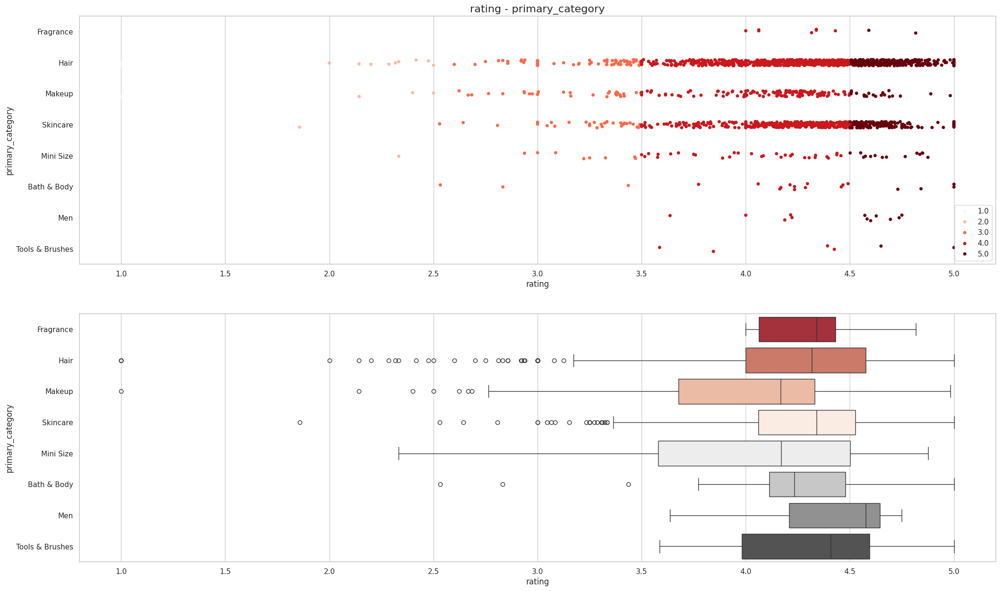

In [235]:
fig, axes = plt.subplots(2,1, figsize=(25,15))
sns.stripplot(data=df5, x='rating', palette='Reds', hue='rounded_rating', y='primary_category', orient='h', ax=axes[0])
axes[0].set_title('rating - primary_category', fontsize='16')
axes[0].legend(loc=4)
sns.boxplot(data=df5, x='rating', palette='RdGy', y='primary_category', orient='h', ax=axes[1])
plt.show()

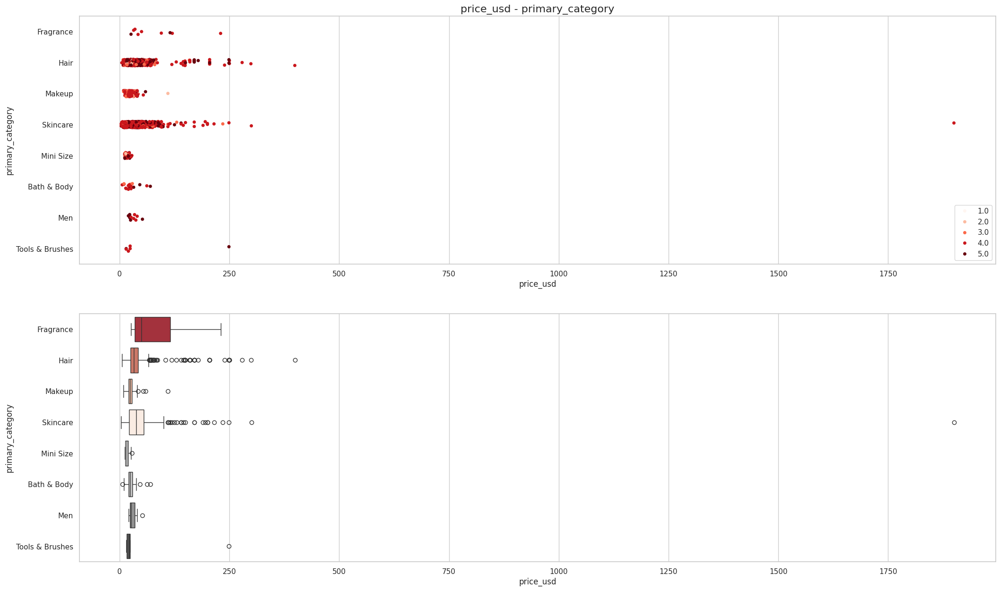

In [236]:
fig, axes = plt.subplots(2,1, figsize=(25,15))
sns.stripplot(data=df5, x='price_usd', palette='Reds', hue='rounded_rating', y='primary_category', orient='h', ax=axes[0])
axes[0].set_title('price_usd - primary_category', fontsize='16')
axes[0].legend(loc=4)
sns.boxplot(data=df5, x='price_usd', palette='RdGy', y='primary_category', orient='h', ax=axes[1])
plt.show()

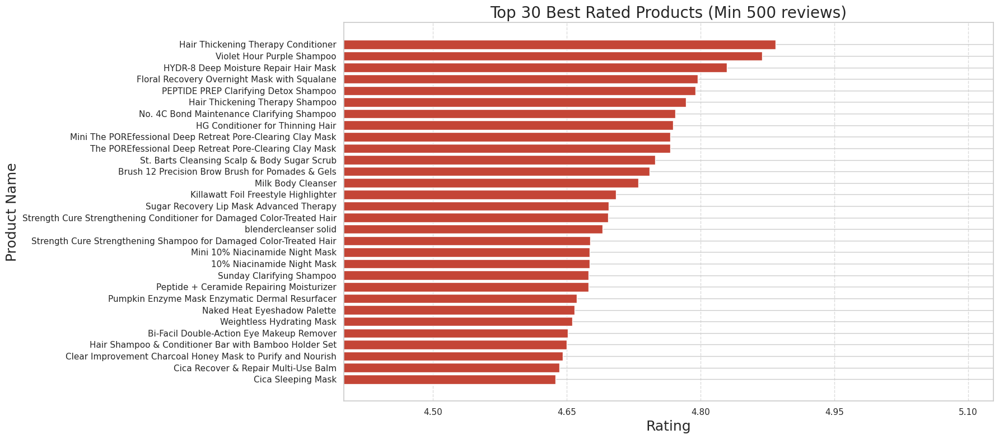

In [237]:
plt.figure(figsize=(18, 8), dpi=100)
brands1 = df[['product_name', 'brand_name', 'reviews', 'rating']].query('reviews > 500').sort_values('rating', ascending=False).head(30)
plt.barh(brands1['product_name'], brands1['rating'], color='#C44536')
plt.title('Top 30 Best Rated Products (Min 500 reviews)', fontsize=20)
plt.xlabel('Rating', fontsize=18)
plt.ylabel('Product Name', fontsize=18)
plt.gca().xaxis.set_major_locator(ticker.MaxNLocator(5))
plt.gca().invert_yaxis()
plt.xlim(4.4)
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

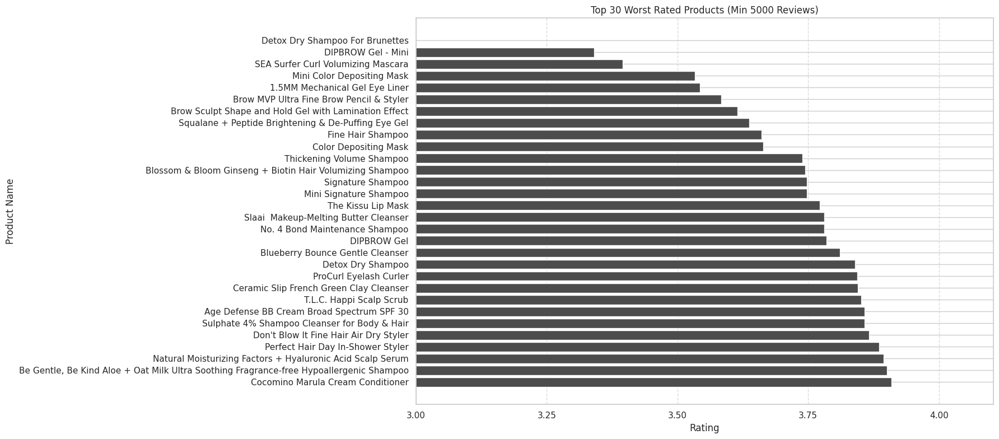

In [238]:
plt.figure(figsize=(18, 8))
brands2 = df[['product_name', 'brand_name', 'reviews', 'rating', ]].query('reviews > 500').reset_index().sort_values('rating', ascending=True).head(30)
plt.barh(brands2['product_name'], brands2['rating'], color='#4C4C4C')
plt.title('Top 30 Worst Rated Products (Min 5000 Reviews)')
plt.xlabel('Rating')
plt.ylabel('Product Name')
plt.gca().xaxis.set_major_locator(ticker.MaxNLocator(5))
plt.gca().invert_yaxis()
plt.xlim(3)
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

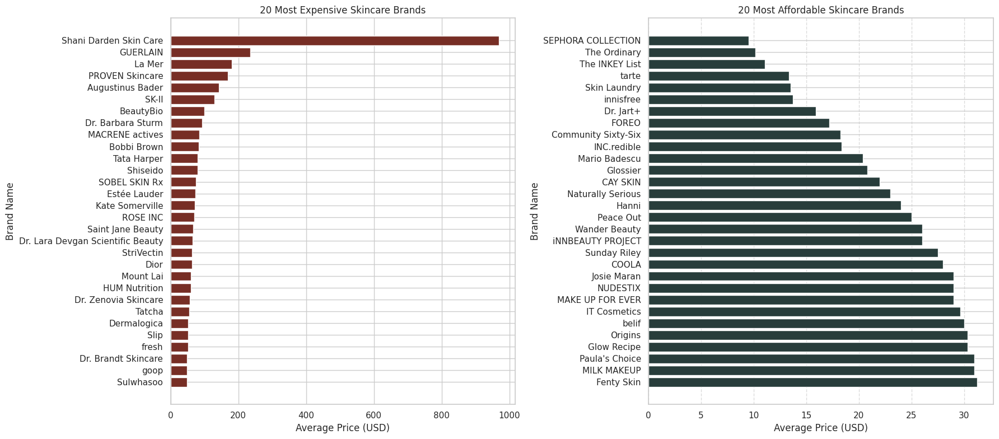

In [239]:
brands3 = df.query('primary_category == "Skincare"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True)
lowest = df.query('primary_category == "Skincare"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).head(30)
lowest = lowest.iloc[::-1]
highest = df.query('primary_category == "Skincare"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).tail(30)
fig, axs = plt.subplots(1, 2, figsize=(18, 8))
axs[0].barh(highest.index.get_level_values('brand_name'), highest.values, color='#772E25')
axs[0].set_xlabel('Average Price (USD)')
axs[0].set_ylabel('Brand Name')
axs[0].set_title('20 Most Expensive Skincare Brands')
axs[1].barh(lowest.index.get_level_values('brand_name'), lowest.values, color='#283D3B')
axs[1].set_xlabel('Average Price (USD)')
axs[1].set_ylabel('Brand Name')
axs[1].set_title('20 Most Affordable Skincare Brands')
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

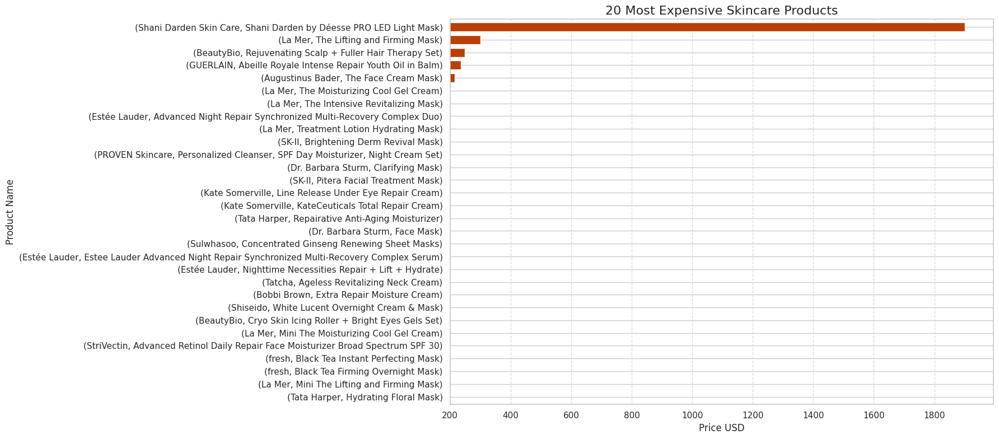

In [240]:
plt.figure(figsize=(18, 8))
makeup_price = df[['product_name', 'brand_name', 'primary_category', 'price_usd', 'secondary_category']].query('primary_category == "Skincare"').nlargest(30, 'price_usd')
prices = makeup_price.drop(columns=['primary_category', 'secondary_category']).groupby(['brand_name', 'product_name'])['price_usd'].max().sort_values(ascending=False).iloc[::-1]
prices.plot(kind='barh', color='#bb3e03', width=0.7)
plt.title('20 Most Expensive Skincare Products', fontdict={'fontsize': 16})
plt.xlabel('Price USD')
plt.ylabel('Product Name')
plt.xlim(200)
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

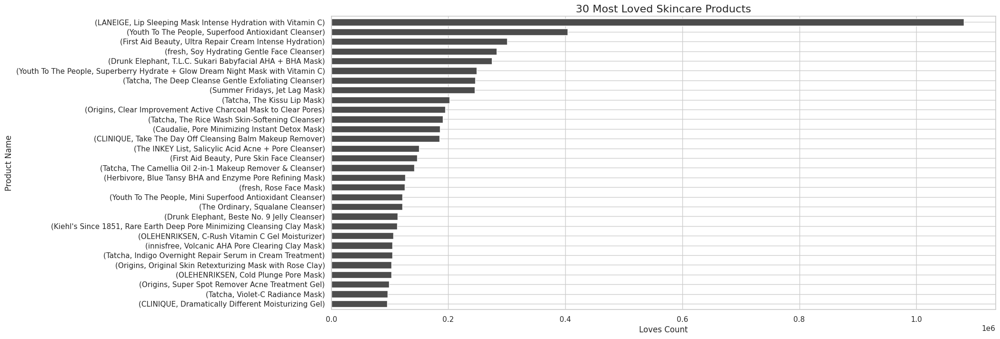

In [241]:
plt.figure(figsize=(18, 8))
brandss = df.query('primary_category == "Skincare"').groupby(['brand_name', 'product_name'])['loves_count'].sum().sort_values(ascending=False).head(30).iloc[::-1]
brandss.plot(kind='barh',  color='#4C4C4C', width=0.7)
plt.title('30 Most Loved Skincare Products', fontdict={'fontsize': 16})
plt.xlabel('Loves Count')
plt.ylabel('Product Name')
plt.show()

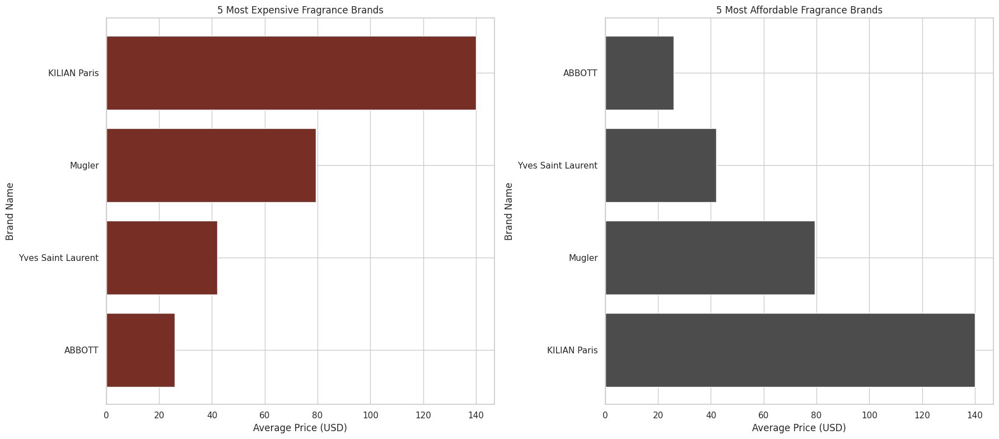

In [242]:
brands3 = df.query('primary_category == "Fragrance"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True)
lowest = df.query('primary_category == "Fragrance"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).head(30)
lowest = lowest.iloc[::-1]
highest = df.query('primary_category == "Fragrance"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).tail(30)
fig, axs = plt.subplots(1, 2, figsize=(18, 8))
axs[0].barh(highest.index.get_level_values('brand_name'), highest.values, color='#772E25')
axs[0].set_xlabel('Average Price (USD)')
axs[0].set_ylabel('Brand Name')
axs[0].set_title('5 Most Expensive Fragrance Brands')
axs[1].barh(lowest.index.get_level_values('brand_name'), lowest.values, color='#4C4C4C')
axs[1].set_xlabel('Average Price (USD)')
axs[1].set_ylabel('Brand Name')
axs[1].set_title('5 Most Affordable Fragrance Brands')
plt.tight_layout()
plt.show()

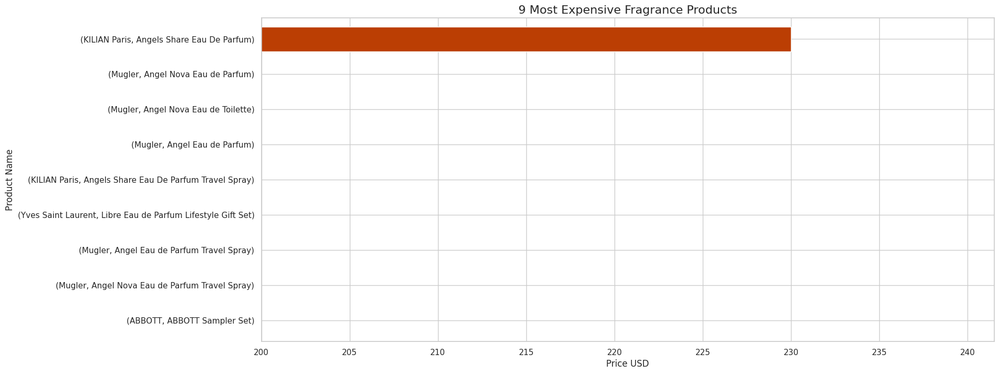

In [243]:
plt.figure(figsize=(18, 8))
makeup_price = df[['product_name', 'brand_name', 'primary_category', 'price_usd', 'secondary_category']].query('primary_category == "Fragrance"').nlargest(30, 'price_usd')
prices = makeup_price.drop(columns=['primary_category', 'secondary_category']).groupby(['brand_name', 'product_name'])['price_usd'].max().sort_values(ascending=False).iloc[::-1]
prices.plot(kind='barh', color='#bb3e03', width=0.7)
plt.title('9 Most Expensive Fragrance Products', fontdict={'fontsize': 16})
plt.xlabel('Price USD')
plt.ylabel('Product Name')
plt.xlim(200)
plt.show()

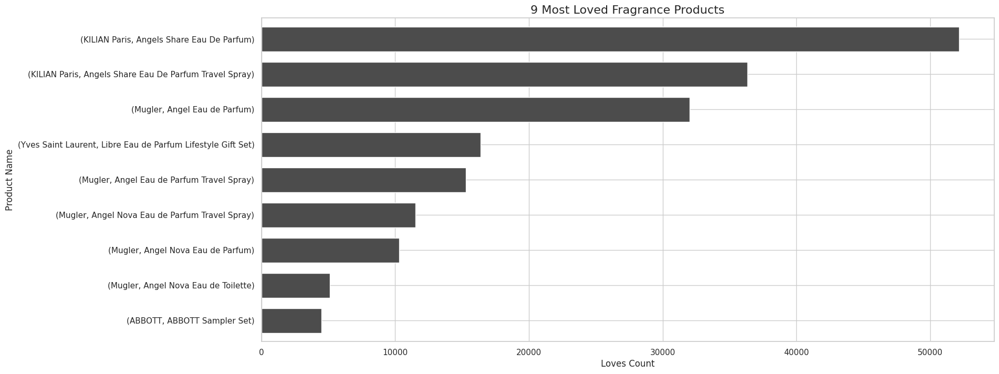

In [244]:
plt.figure(figsize=(18, 8))
brandss = df.query('primary_category == "Fragrance"').groupby(['brand_name', 'product_name'])['loves_count'].sum().sort_values(ascending=False).head(30).iloc[::-1]
brandss.plot(kind='barh',  color='#4C4C4C', width=0.7)
plt.title('9 Most Loved Fragrance Products', fontdict={'fontsize': 16})
plt.xlabel('Loves Count')
plt.ylabel('Product Name')
plt.show()

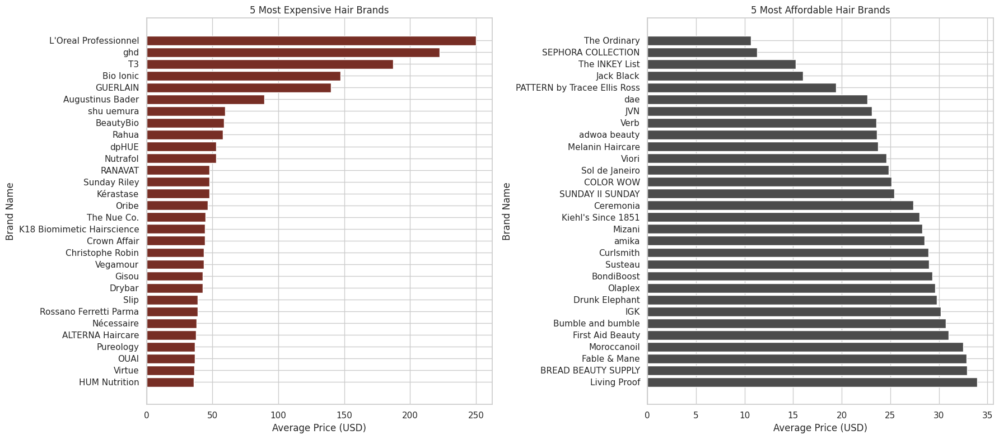

In [245]:
brands3 = df.query('primary_category == "Hair"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True)
lowest = df.query('primary_category == "Hair"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).head(30)
lowest = lowest.iloc[::-1]
highest = df.query('primary_category == "Hair"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).tail(30)
fig, axs = plt.subplots(1, 2, figsize=(18, 8))
axs[0].barh(highest.index.get_level_values('brand_name'), highest.values, color='#772E25')
axs[0].set_xlabel('Average Price (USD)')
axs[0].set_ylabel('Brand Name')
axs[0].set_title('5 Most Expensive Hair Brands')
axs[1].barh(lowest.index.get_level_values('brand_name'), lowest.values, color='#4C4C4C')
axs[1].set_xlabel('Average Price (USD)')
axs[1].set_ylabel('Brand Name')
axs[1].set_title('5 Most Affordable Hair Brands')
plt.tight_layout()
plt.show()

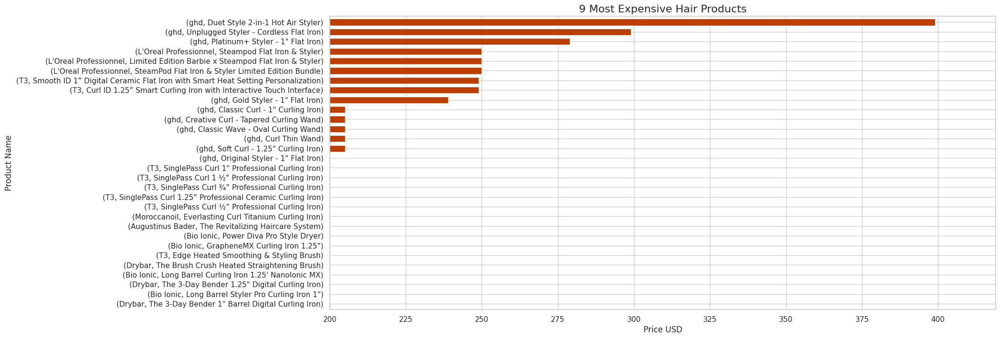

In [246]:
plt.figure(figsize=(18, 8))
makeup_price = df[['product_name', 'brand_name', 'primary_category', 'price_usd', 'secondary_category']].query('primary_category == "Hair"').nlargest(30, 'price_usd')
prices = makeup_price.drop(columns=['primary_category', 'secondary_category']).groupby(['brand_name', 'product_name'])['price_usd'].max().sort_values(ascending=False).iloc[::-1]
prices.plot(kind='barh', color='#bb3e03', width=0.7)
plt.title('9 Most Expensive Hair Products', fontdict={'fontsize': 16})
plt.xlabel('Price USD')
plt.ylabel('Product Name')
plt.xlim(200)
plt.show()

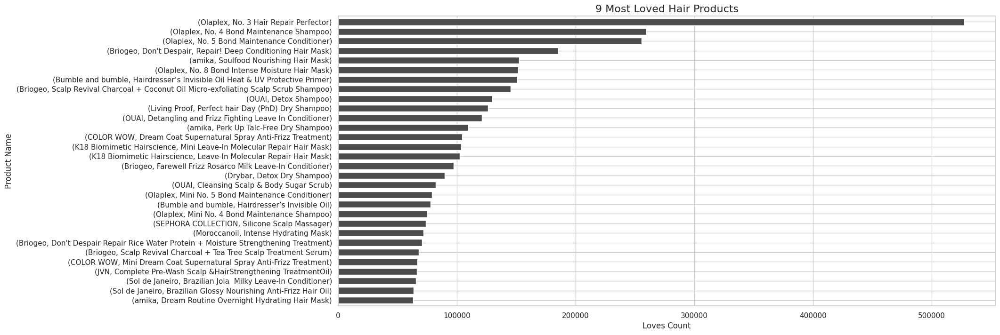

In [247]:
plt.figure(figsize=(18, 8))
brandss = df.query('primary_category == "Hair"').groupby(['brand_name', 'product_name'])['loves_count'].sum().sort_values(ascending=False).head(30).iloc[::-1]
brandss.plot(kind='barh',  color='#4C4C4C', width=0.7)
plt.title('9 Most Loved Hair Products', fontdict={'fontsize': 16})
plt.xlabel('Loves Count')
plt.ylabel('Product Name')
plt.show()

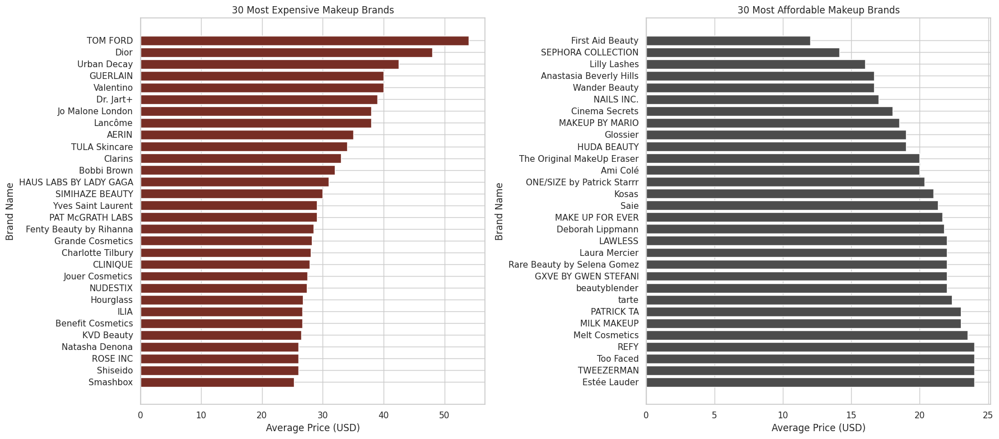

In [248]:
brands3 = df.query('primary_category == "Makeup"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True)
lowest = df.query('primary_category == "Makeup"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).head(30)
lowest = lowest.iloc[::-1]
highest = df.query('primary_category == "Makeup"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).tail(30)
fig, axs = plt.subplots(1, 2, figsize=(18, 8))
axs[0].barh(highest.index.get_level_values('brand_name'), highest.values, color='#772E25')
axs[0].set_xlabel('Average Price (USD)')
axs[0].set_ylabel('Brand Name')
axs[0].set_title('30 Most Expensive Makeup Brands')
axs[1].barh(lowest.index.get_level_values('brand_name'), lowest.values, color='#4C4C4C')
axs[1].set_xlabel('Average Price (USD)')
axs[1].set_ylabel('Brand Name')
axs[1].set_title('30 Most Affordable Makeup Brands')
plt.tight_layout()
plt.show()

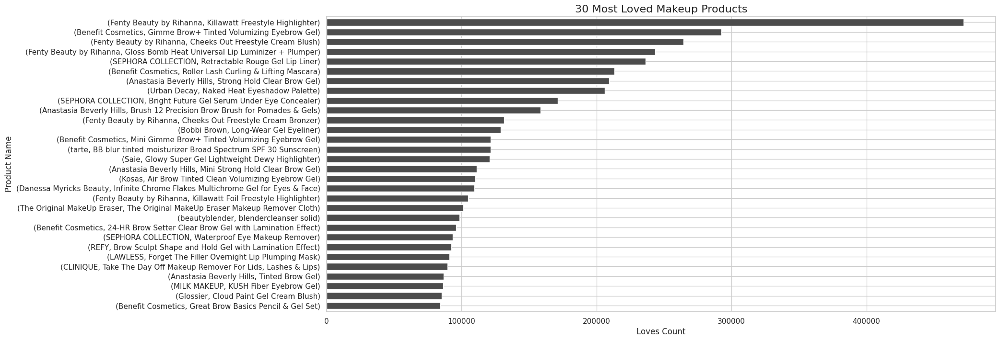

In [249]:
plt.figure(figsize=(18, 8))
brandss = df.query('primary_category == "Makeup"').groupby(['brand_name', 'product_name'])['loves_count'].sum().sort_values(ascending=False).head(30).iloc[::-1]
brandss.plot(kind='barh',  color='#4C4C4C', width=0.7)
plt.title('30 Most Loved Makeup Products', fontdict={'fontsize': 16})
plt.xlabel('Loves Count')
plt.ylabel('Product Name')
plt.show()

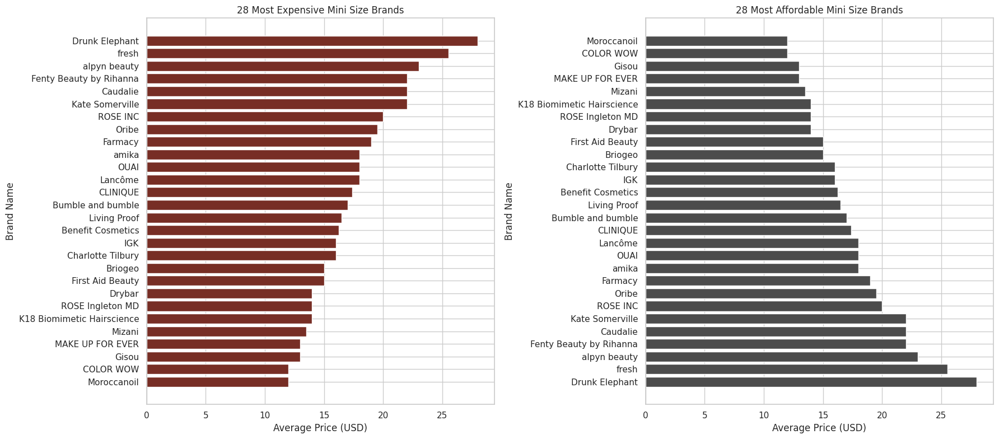

In [250]:
brands3 = df.query('primary_category == "Mini Size"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True)
lowest = df.query('primary_category == "Mini Size"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).head(30)
lowest = lowest.iloc[::-1]
highest = df.query('primary_category == "Mini Size"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).tail(30)
fig, axs = plt.subplots(1, 2, figsize=(18, 8))
axs[0].barh(highest.index.get_level_values('brand_name'), highest.values, color='#772E25')
axs[0].set_xlabel('Average Price (USD)')
axs[0].set_ylabel('Brand Name')
axs[0].set_title('28 Most Expensive Mini Size Brands')
axs[1].barh(lowest.index.get_level_values('brand_name'), lowest.values, color='#4C4C4C')
axs[1].set_xlabel('Average Price (USD)')
axs[1].set_ylabel('Brand Name')
axs[1].set_title('28 Most Affordable Mini Size Brands')
plt.tight_layout()
plt.show()

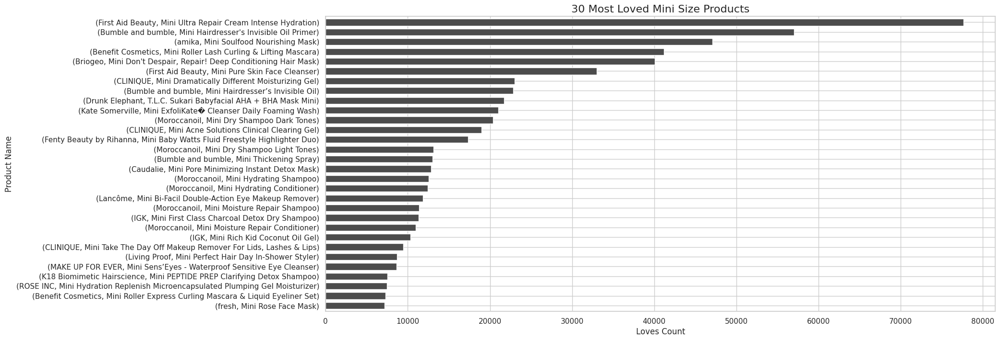

In [251]:
plt.figure(figsize=(18, 8))
brandss = df.query('primary_category == "Mini Size"').groupby(['brand_name', 'product_name'])['loves_count'].sum().sort_values(ascending=False).head(30).iloc[::-1]
brandss.plot(kind='barh',  color='#4C4C4C', width=0.7)
plt.title('30 Most Loved Mini Size Products', fontdict={'fontsize': 16})
plt.xlabel('Loves Count')
plt.ylabel('Product Name')
plt.show()

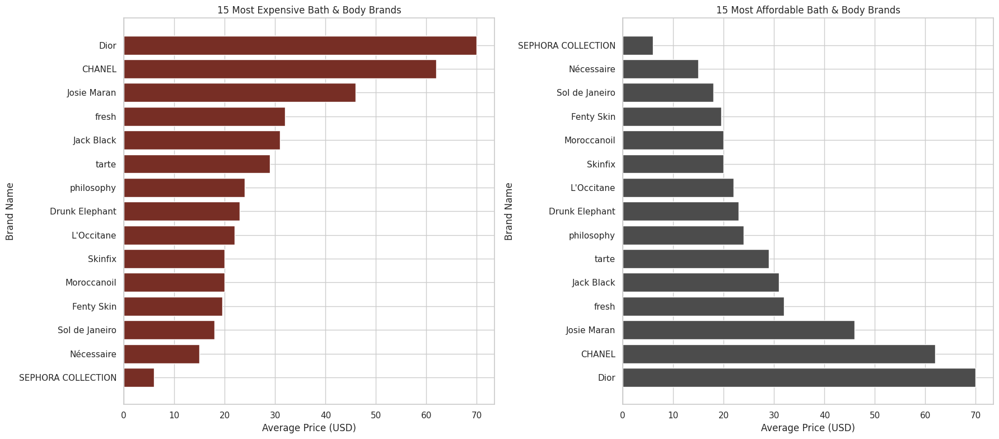

In [252]:
brands3 = df.query('primary_category == "Bath & Body"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True)
lowest = df.query('primary_category == "Bath & Body"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).head(30)
lowest = lowest.iloc[::-1]
highest = df.query('primary_category == "Bath & Body"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).tail(30)
fig, axs = plt.subplots(1, 2, figsize=(18, 8))
axs[0].barh(highest.index.get_level_values('brand_name'), highest.values, color='#772E25')
axs[0].set_xlabel('Average Price (USD)')
axs[0].set_ylabel('Brand Name')
axs[0].set_title('15 Most Expensive Bath & Body Brands')
axs[1].barh(lowest.index.get_level_values('brand_name'), lowest.values, color='#4C4C4C')
axs[1].set_xlabel('Average Price (USD)')
axs[1].set_ylabel('Brand Name')
axs[1].set_title('15 Most Affordable Bath & Body Brands')
plt.tight_layout()
plt.show()

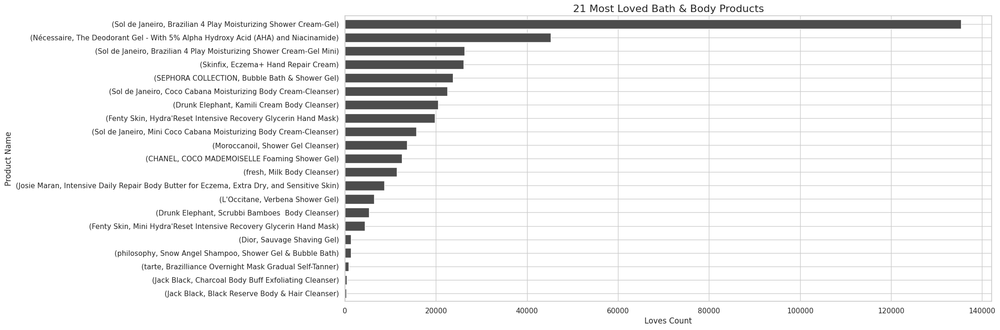

In [253]:
plt.figure(figsize=(18, 8))
brandss = df.query('primary_category == "Bath & Body"').groupby(['brand_name', 'product_name'])['loves_count'].sum().sort_values(ascending=False).head(30).iloc[::-1]
brandss.plot(kind='barh',  color='#4C4C4C', width=0.7)
plt.title('21 Most Loved Bath & Body Products', fontdict={'fontsize': 16})
plt.xlabel('Loves Count')
plt.ylabel('Product Name')
plt.show()

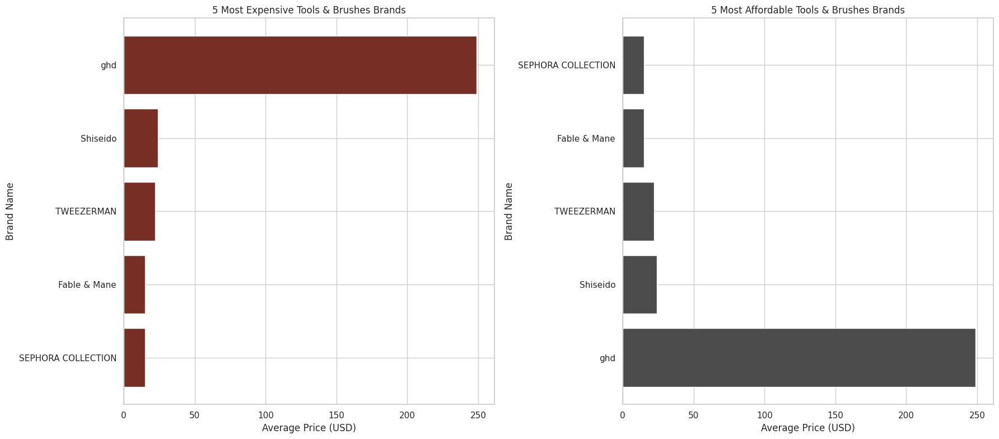

In [254]:
brands3 = df.query('primary_category == "Tools & Brushes"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True)
lowest = df.query('primary_category == "Tools & Brushes"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).head(30)
lowest = lowest.iloc[::-1]
highest = df.query('primary_category == "Tools & Brushes"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).tail(30)
fig, axs = plt.subplots(1, 2, figsize=(18, 8))
axs[0].barh(highest.index.get_level_values('brand_name'), highest.values, color='#772E25')
axs[0].set_xlabel('Average Price (USD)')
axs[0].set_ylabel('Brand Name')
axs[0].set_title('5 Most Expensive Tools & Brushes Brands')
axs[1].barh(lowest.index.get_level_values('brand_name'), lowest.values, color='#4C4C4C')
axs[1].set_xlabel('Average Price (USD)')
axs[1].set_ylabel('Brand Name')
axs[1].set_title('5 Most Affordable Tools & Brushes Brands')
plt.tight_layout()
plt.show()

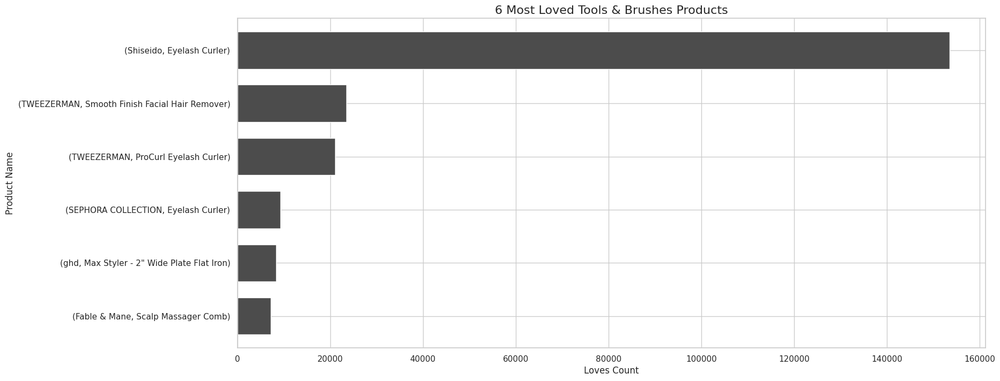

In [255]:
plt.figure(figsize=(18, 8))
brandss = df.query('primary_category == "Tools & Brushes"').groupby(['brand_name', 'product_name'])['loves_count'].sum().sort_values(ascending=False).head(30).iloc[::-1]
brandss.plot(kind='barh',  color='#4C4C4C', width=0.7)
plt.title('6 Most Loved Tools & Brushes Products', fontdict={'fontsize': 16})
plt.xlabel('Loves Count')
plt.ylabel('Product Name')
plt.show()

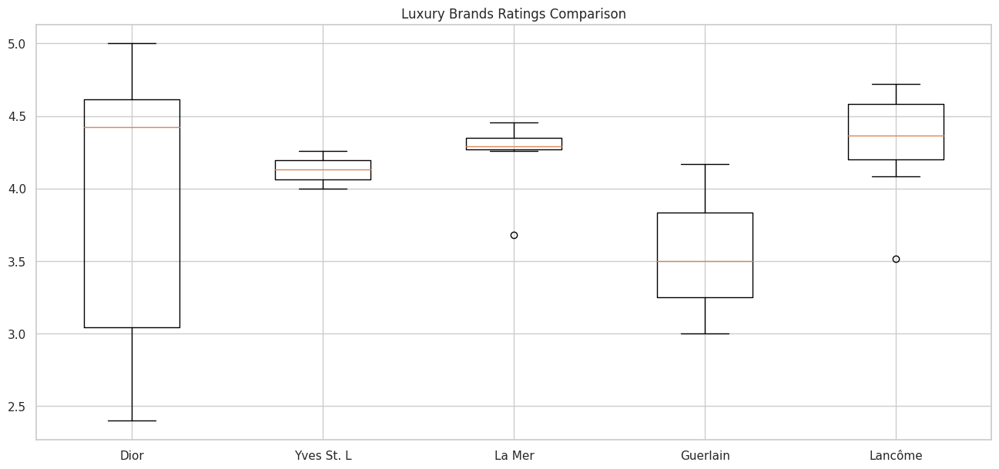

In [256]:
dr = df.query('brand_name == "Dior"')
ysl = df.query('brand_name == "Yves Saint Laurent"')
lm = df.query('brand_name == "La Mer"')
gr = df.query('brand_name == "GUERLAIN"')
lc = df.query('brand_name == "Lancôme"')
dior = dr['rating'].dropna()
ystl = ysl['rating'].dropna()
guerlain = gr['rating'].dropna()
lamer = lm['rating'].dropna()
lancome = lc['rating'].dropna()
labels = ['Dior', 'Yves St. L', 'La Mer', 'Guerlain', 'Lancôme']
plt.figure(figsize=(16, 7))
plt.title('Luxury Brands Ratings Comparison')
plt.boxplot([dior, ystl, lamer, guerlain, lancome], labels=labels)
plt.show()

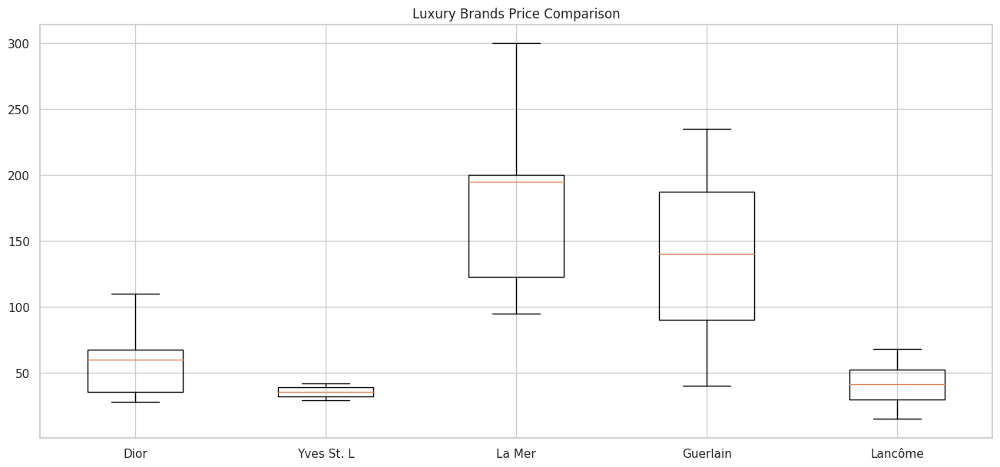

In [257]:
dr = df.query('brand_name == "Dior"')
ysl = df.query('brand_name == "Yves Saint Laurent"')
lm = df.query('brand_name == "La Mer"')
gr = df.query('brand_name == "GUERLAIN"')
lc = df.query('brand_name == "Lancôme"')
dior = dr['price_usd'].dropna()
ystl = ysl['price_usd'].dropna()
guerlain = gr['price_usd'].dropna()
lamer = lm['price_usd'].dropna()
lancome = lc['price_usd'].dropna()
labels = ['Dior', 'Yves St. L', 'La Mer', 'Guerlain', 'Lancôme']
plt.figure(figsize=(16, 7))
plt.title('Luxury Brands Price Comparison')
plt.boxplot([dior, ystl, lamer, guerlain, lancome], labels=labels)
plt.show()

In [258]:
# Getting the files
df1 = pd.read_csv("/content/reviews_0-250.csv", low_memory=False)
df2 = pd.read_csv("/content/reviews_250-500.csv", low_memory=False)
df3 = pd.read_csv("/content/reviews_500-750.csv", low_memory=False)
df4 = pd.read_csv("/content/reviews_750-1250.csv", low_memory=False)
df5 = pd.read_csv("/content/reviews_1250-end.csv", low_memory=False)
# Combining the dfs
dr = pd.concat([df1,df2,df3,df4,df5])
dr.info()


<class 'pandas.core.frame.DataFrame'>
Index: 708999 entries, 0 to 49976
Data columns (total 19 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   Unnamed: 0                708999 non-null  int64  
 1   author_id                 708999 non-null  object 
 2   rating                    708999 non-null  int64  
 3   is_recommended            607514 non-null  float64
 4   helpfulness               358504 non-null  float64
 5   total_feedback_count      708999 non-null  int64  
 6   total_neg_feedback_count  708999 non-null  int64  
 7   total_pos_feedback_count  708999 non-null  int64  
 8   submission_time           708999 non-null  object 
 9   review_text               708050 non-null  object 
 10  review_title              506298 non-null  object 
 11  skin_tone                 600364 non-null  object 
 12  eye_color                 578879 non-null  object 
 13  skin_type                 642558 non-null  object 

In [259]:
dr.columns

Index(['Unnamed: 0', 'author_id', 'rating', 'is_recommended', 'helpfulness',
       'total_feedback_count', 'total_neg_feedback_count',
       'total_pos_feedback_count', 'submission_time', 'review_text',
       'review_title', 'skin_tone', 'eye_color', 'skin_type', 'hair_color',
       'product_id', 'product_name', 'brand_name', 'price_usd'],
      dtype='object')

In [260]:
dr.shape

(708999, 19)

In [261]:
def check_dr(dr: object, head: object = 5) -> object:
    print("\nShape")
    print(dr.shape)
    print("\nTypes")
    print(dr.dtypes)
    print("\nNANs")
    print(dr.isnull().sum())
    print("\nInfo")
    print(dr.info())
check_dr(dr)


Shape
(708999, 19)

Types
Unnamed: 0                    int64
author_id                    object
rating                        int64
is_recommended              float64
helpfulness                 float64
total_feedback_count          int64
total_neg_feedback_count      int64
total_pos_feedback_count      int64
submission_time              object
review_text                  object
review_title                 object
skin_tone                    object
eye_color                    object
skin_type                    object
hair_color                   object
product_id                   object
product_name                 object
brand_name                   object
price_usd                   float64
dtype: object

NANs
Unnamed: 0                       0
author_id                        0
rating                           0
is_recommended              101485
helpfulness                 350495
total_feedback_count             0
total_neg_feedback_count         0
total_pos_feedback_count

In [262]:
print('Number of duplicated rows: ' , len(dr[dr.duplicated()]))

Number of duplicated rows:  0


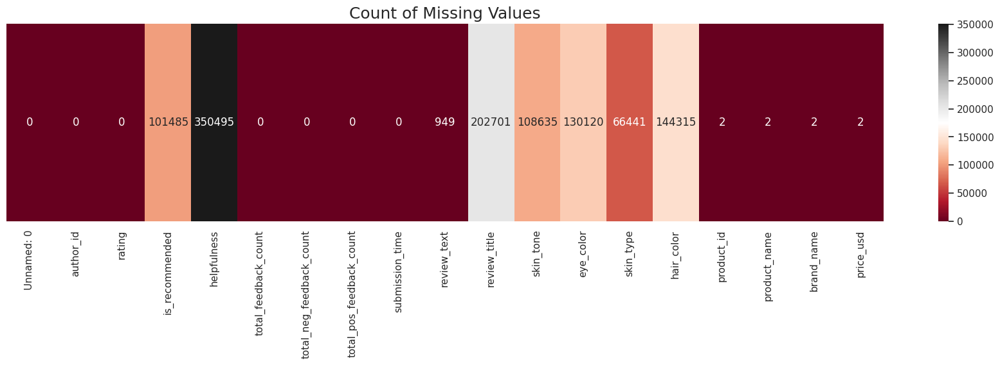

In [263]:
plt.figure(figsize=(22,4))
sns.heatmap((dr.isna().sum()).to_frame(name='').T,cmap='RdGy', annot=True,
             fmt='0.0f').set_title('Count of Missing Values', fontsize=18)
plt.show()

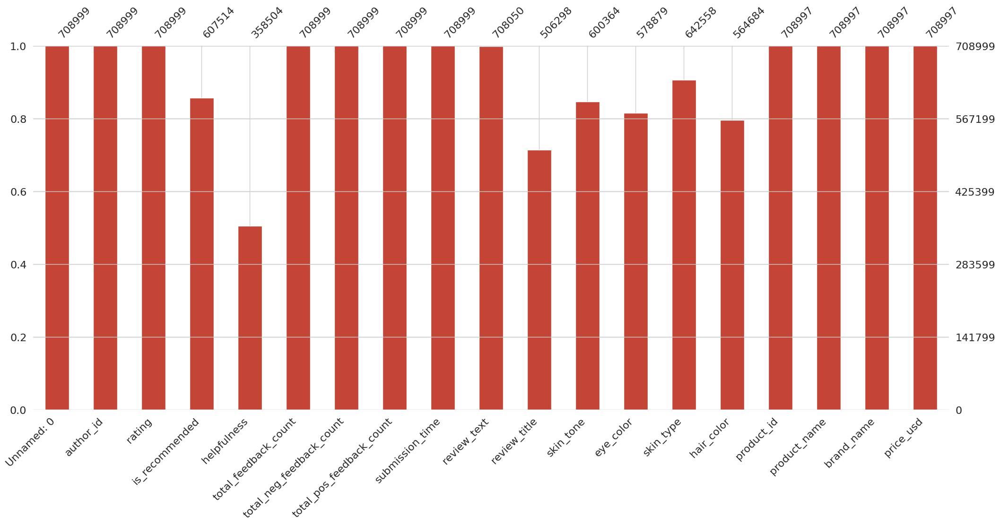

In [264]:
msno.bar(dr, color='#C44536')
plt.show()

In [265]:
pct_missing = dr.isna().mean()
pct_missing

,0
Unnamed: 0,0.000000
author_id,0.000000
rating,0.000000
is_recommended,0.143138
helpfulness,0.494352
total_feedback_count,0.000000
total_neg_feedback_count,0.000000
total_pos_feedback_count,0.000000
submission_time,0.000000
review_text,0.001339


<Axes: >

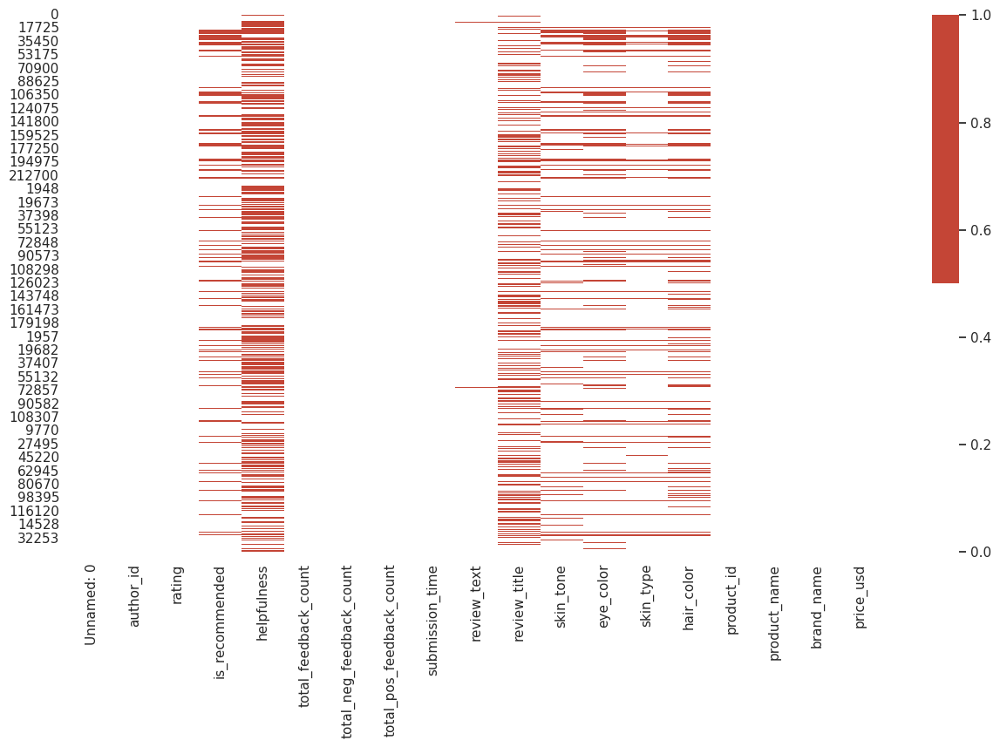

In [266]:
plt.figure(figsize=(15,8))
cols= dr.columns
colors=['#ffffff','#C44536']
sns.heatmap(dr[cols].isna(),cmap=sns.color_palette(colors))

In [267]:
dr.describe().T.style.background_gradient(cmap='RdGy', axis=1)

,count,mean,std,min,25%,50%,75%,max
Unnamed: 0,708999.000000,84953.484665,58911.859704,0.000000,35449.500000,76130.000000,123096.000000,228476.000000
rating,708999.000000,4.307701,1.150602,1.000000,4.000000,5.000000,5.000000,5.000000
is_recommended,607514.000000,0.841892,0.364843,0.000000,1.000000,1.000000,1.000000,1.000000
helpfulness,358504.000000,0.771574,0.314254,0.000000,0.666667,0.933333,1.000000,1.000000
total_feedback_count,708999.000000,4.390582,22.871320,0.000000,0.000000,1.000000,4.000000,5464.000000
total_neg_feedback_count,708999.000000,0.947395,5.673865,0.000000,0.000000,0.000000,1.000000,1159.000000
total_pos_feedback_count,708999.000000,3.443187,19.722299,0.000000,0.000000,0.000000,3.000000,5050.000000
price_usd,708997.000000,48.483944,40.170691,3.000000,24.000000,39.000000,62.000000,1900.000000


In [268]:
# finding unique data
dr.apply(lambda x: len(x.unique()))

,0
Unnamed: 0,228477
author_id,367680
rating,5
is_recommended,3
helpfulness,3073
total_feedback_count,553
total_neg_feedback_count,232
total_pos_feedback_count,488
submission_time,5316
review_text,637584
